In [2]:
#importing libraries 
import pandas as pd
import numpy as np 
from pandas import DataFrame
from pandas.plotting import scatter_matrix
import matplotlib.pyplot as plt
from matplotlib import pyplot, pyplot as plt
import seaborn as sns
from matplotlib import rcParams
import plotly as py
import plotly.graph_objects as go
import plotly.express as px
from plotly.colors import n_colors 
%matplotlib inline
from matplotlib import rc
import scipy.stats
from scipy.stats import norm
from scipy.stats.mstats import winsorize
import plotly.subplots as sp
from scipy import stats
import warnings
import math
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import LabelEncoder
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error, r2_score

In [3]:
#loading the dataset
life_data = pd.read_csv('Life Expectancy Data.csv', skipinitialspace=True)
pd.set_option('display.max_columns', None)
life_data

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,83,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,86,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,89,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,93,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,97,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,42,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,41,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,40,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,39,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [4]:
#checking data shape
life_data.shape 

(2938, 22)

In [5]:
#checking data types
life_data.dtypes

Country                             object
Year                                 int64
Status                              object
Life expectancy                    float64
Adult Mortality                    float64
infant deaths                        int64
Alcohol                            float64
percentage expenditure             float64
Hepatitis B                        float64
Measles                              int64
BMI                                float64
under-five deaths                    int64
Polio                              float64
Total expenditure                  float64
Diphtheria                         float64
HIV/AIDS                           float64
GDP                                float64
Population                         float64
thinness  1-19 years               float64
thinness 5-9 years                 float64
Income composition of resources    float64
Schooling                          float64
dtype: object

In [6]:
#checking columns
life_data.columns

Index(['Country', 'Year', 'Status', 'Life expectancy ', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles ', 'BMI ', 'under-five deaths ', 'Polio', 'Total expenditure',
       'Diphtheria ', 'HIV/AIDS', 'GDP', 'Population', 'thinness  1-19 years',
       'thinness 5-9 years', 'Income composition of resources', 'Schooling'],
      dtype='object')

In [7]:
#renaming columns to remove white spaces and to maintain consistency 
life_data.rename(columns = {" BMI " :"BMI", 
                                  "Life expectancy ": "Life_expectancy",
                                  "Adult Mortality":"Adult_mortality",
                                  "infant deaths":"Infant_deaths",
                                  "percentage expenditure":"Percentage_expenditure",
                                  "Hepatitis B":"HepatitisB",
                                  "Measles ":"Measles",
                                  "under-five deaths ": "Under_five_deaths",
                                  "Total expenditure":"Total_expenditure",
                                  "Diphtheria ": "Diphtheria",
                                  " thinness  1-19 years":"thinness_1-19_years",
                                  " thinness 5-9 years":"thinness_5-9_years",
                                  " HIV/AIDS":"HIV/AIDS",
                                  "Income composition of resources":"Income_composition_of_resources"}, inplace = True)
life_data = life_data.rename(columns=lambda x: x.strip().replace(" ", ""))

In [8]:
#confriming column names without whitespaces
life_data.columns

Index(['Country', 'Year', 'Status', 'Life_expectancy', 'Adult_mortality',
       'Infant_deaths', 'Alcohol', 'Percentage_expenditure', 'HepatitisB',
       'Measles', 'BMI', 'Under_five_deaths', 'Polio', 'Total_expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'thinness1-19years',
       'thinness5-9years', 'Income_composition_of_resources', 'Schooling'],
      dtype='object')

In [9]:
#checking the years represented in the dataset
min_year = life_data['Year'].min()
max_year = life_data['Year'].max()
print ('The years represented in this dataset is from' , min_year, 'to' , max_year)

The years represented in this dataset is from 2000 to 2015


In [10]:
#checking the countries represented in the dataset
country = life_data.groupby('Country')
for key,value in country:
    print(key)

Afghanistan
Albania
Algeria
Angola
Antigua and Barbuda
Argentina
Armenia
Australia
Austria
Azerbaijan
Bahamas
Bahrain
Bangladesh
Barbados
Belarus
Belgium
Belize
Benin
Bhutan
Bolivia (Plurinational State of)
Bosnia and Herzegovina
Botswana
Brazil
Brunei Darussalam
Bulgaria
Burkina Faso
Burundi
Cabo Verde
Cambodia
Cameroon
Canada
Central African Republic
Chad
Chile
China
Colombia
Comoros
Congo
Cook Islands
Costa Rica
Croatia
Cuba
Cyprus
Czechia
Côte d'Ivoire
Democratic People's Republic of Korea
Democratic Republic of the Congo
Denmark
Djibouti
Dominica
Dominican Republic
Ecuador
Egypt
El Salvador
Equatorial Guinea
Eritrea
Estonia
Ethiopia
Fiji
Finland
France
Gabon
Gambia
Georgia
Germany
Ghana
Greece
Grenada
Guatemala
Guinea
Guinea-Bissau
Guyana
Haiti
Honduras
Hungary
Iceland
India
Indonesia
Iran (Islamic Republic of)
Iraq
Ireland
Israel
Italy
Jamaica
Japan
Jordan
Kazakhstan
Kenya
Kiribati
Kuwait
Kyrgyzstan
Lao People's Democratic Republic
Latvia
Lebanon
Lesotho
Liberia
Libya
Lithuania
L

In [11]:
# checking the countries represented in the dataset
total_countries = life_data['Country'].nunique()
print('Total number of countries represented in the Life Expectancy Dataset:', total_countries)

Total number of countries represented in the Life Expectancy Dataset: 193


In [12]:
life_data['Year'].unique()

array([2015, 2014, 2013, 2012, 2011, 2010, 2009, 2008, 2007, 2006, 2005,
       2004, 2003, 2002, 2001, 2000], dtype=int64)

In [13]:
#checking unique values in the Country column 
pd.set_option('display.max_rows', None)
life_data['Country'].value_counts()

Afghanistan                                             16
Peru                                                    16
Nicaragua                                               16
Niger                                                   16
Nigeria                                                 16
Norway                                                  16
Oman                                                    16
Pakistan                                                16
Panama                                                  16
Papua New Guinea                                        16
Paraguay                                                16
Philippines                                             16
Lebanon                                                 16
Poland                                                  16
Portugal                                                16
Qatar                                                   16
Republic of Korea                                       

In [14]:
#calculating count of countries (rows) 
counts = life_data['Country'].value_counts()

#setting boolean conditional statement to delete countries with with less than 15 years of records
mask = life_data['Country'].isin(counts[counts < 16].index)

#dropping countries with less than 16 years record 
life_data.drop(life_data[mask].index, inplace=True)
#print(life_data)
#confriming countries with less than 16 counts have been dropped 
#life_data['Country'].value_counts()

In [15]:
#checking the number of unques values in the status column
life_data['Status'].value_counts(dropna=False)

Developing    2416
Developed      512
Name: Status, dtype: int64

In [16]:
#checking the percentage of unique values 
count_of_status = life_data['Status'].value_counts(normalize=True)
count_of_status

Developing    0.825137
Developed     0.174863
Name: Status, dtype: float64

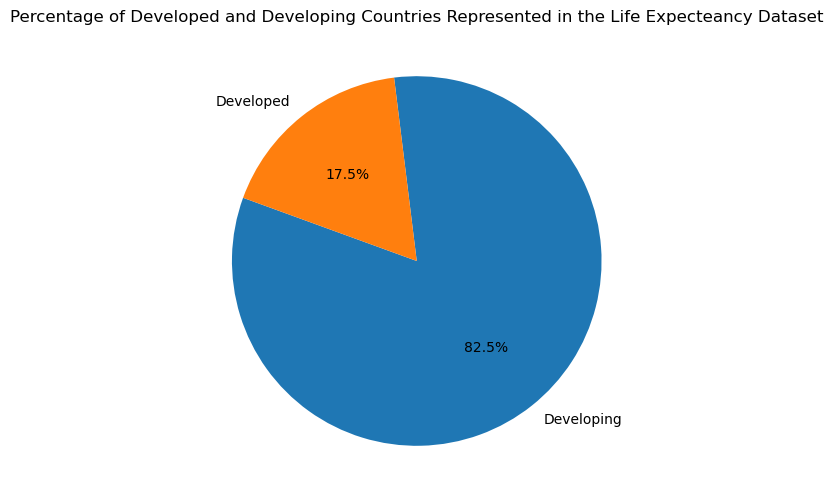

In [17]:
#ploting pie chart to visualize status count
plt.figure(figsize=(12,6))
plt.title('Percentage of Developed and Developing Countries Represented in the Life Expecteancy Dataset')
plt.pie(count_of_status, labels=count_of_status.index, autopct='%2.1f%%', startangle=160);

In [18]:
#checking general info of dataset
life_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2928 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2928 non-null   object 
 1   Year                             2928 non-null   int64  
 2   Status                           2928 non-null   object 
 3   Life_expectancy                  2928 non-null   float64
 4   Adult_mortality                  2928 non-null   float64
 5   Infant_deaths                    2928 non-null   int64  
 6   Alcohol                          2735 non-null   float64
 7   Percentage_expenditure           2928 non-null   float64
 8   HepatitisB                       2375 non-null   float64
 9   Measles                          2928 non-null   int64  
 10  BMI                              2896 non-null   float64
 11  Under_five_deaths                2928 non-null   int64  
 12  Polio               

In [19]:
#checking the total sum of missing values in each column 
print(life_data.isnull().sum())

Country                              0
Year                                 0
Status                               0
Life_expectancy                      0
Adult_mortality                      0
Infant_deaths                        0
Alcohol                            193
Percentage_expenditure               0
HepatitisB                         553
Measles                              0
BMI                                 32
Under_five_deaths                    0
Polio                               19
Total_expenditure                  226
Diphtheria                          19
HIV/AIDS                             0
GDP                                443
Population                         644
thinness1-19years                   32
thinness5-9years                    32
Income_composition_of_resources    160
Schooling                          160
dtype: int64


In [20]:
#checking the total of missing value in the dataset
total_null_values = life_data.isna().sum().sum()
print ('Total null values in the Life expectancy dataset:' +   str(total_null_values ))

Total null values in the Life expectancy dataset:2513


In [21]:
#checking the percentage of missing value 

missing_values = life_data.isnull().sum().sort_values(ascending=False)
perc_missing_values = ((life_data.isnull().sum()/life_data.isnull().count())*100).sort_values(ascending=False)
missing_data = pd.concat([missing_values, perc_missing_values], axis=1,join='outer', keys=['Total Missing Values', '% of Total Observations'])
missing_data.index.name ='Features'
missing_data

,Total Missing Values,% of Total Observations
Features,,
Population,644,21.994536
HepatitisB,553,18.886612
GDP,443,15.129781
Total_expenditure,226,7.718579
Alcohol,193,6.591530
Schooling,160,5.464481
Income_composition_of_resources,160,5.464481
thinness5-9years,32,1.092896
thinness1-19years,32,1.092896


In [22]:
#getting statistical overview of dataset
life_data.describe()

,Year,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,BMI,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling
count,2928.00000,2928.000000,2928.000000,2928.000000,2735.000000,2928.000000,2375.000000,2928.000000,2896.000000,2928.000000,2909.000000,2702.000000,2909.000000,2928.000000,2485.000000,2.284000e+03,2896.000000,2896.000000,2768.000000,2768.000000
mean,2007.50000,69.224932,164.796448,30.407445,4.614856,740.321185,80.960842,2427.855874,38.235394,42.179303,82.548298,5.930163,82.321416,1.747712,7494.210719,1.276454e+07,4.850622,4.881423,0.627419,11.999639
std,4.61056,9.523867,124.292079,118.114450,4.050749,1990.930605,25.018337,11485.970937,19.959590,160.700547,23.416674,2.483273,23.706644,5.085542,14282.251492,6.103765e+07,4.420829,4.509609,0.210978,3.346440
min,2000.00000,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.370000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2003.75000,63.100000,74.000000,0.000000,0.905000,4.853964,77.000000,0.000000,19.300000,0.000000,78.000000,4.260000,78.000000,0.100000,463.852618,1.966738e+05,1.600000,1.575000,0.493000,10.100000
50%,2007.50000,72.100000,144.000000,3.000000,3.770000,65.611455,92.000000,17.000000,43.350000,4.000000,93.000000,5.750000,93.000000,0.100000,1764.973870,1.391756e+06,3.300000,3.400000,0.677000,12.300000
75%,2011.25000,75.700000,228.000000,22.000000,7.715000,442.614322,97.000000,362.250000,56.100000,28.000000,97.000000,7.490000,97.000000,0.800000,5932.899677,7.426746e+06,7.200000,7.200000,0.779250,14.300000
max,2015.00000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,77.600000,2500.000000,99.000000,17.600000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


In [23]:
#replacing extreme values with nan
life_data.Infant_deaths = life_data.Infant_deaths.replace(0, np.nan)
life_data.BMI = life_data.apply(lambda x: np.nan if (x.BMI < 10 or x.BMI > 50) else x.BMI, axis=1)
life_data.Under_five_deaths= life_data.Under_five_deaths.replace(0, np.nan)

#replacing values with nan if it is less than the 5th percentile 
mort_5_percentile = np.percentile(life_data.Adult_mortality.dropna(), 5)
life_data.Adult_mortality = life_data.apply(lambda x: np.nan if x.Adult_mortality < mort_5_percentile else x.Adult_mortality, axis=1)

In [24]:
#checking the percentage of missing value 

missing_values = life_data.isnull().sum().sort_values(ascending=False)
perc_missing_values = ((life_data.isnull().sum()/life_data.isnull().count())*100).sort_values(ascending=False)
missing_data = pd.concat([missing_values, perc_missing_values], axis=1,join='outer', keys=['Total Missing Values', '% of Total Observations'])
missing_data.index.name ='Features'
missing_data

,Total Missing Values,% of Total Observations
Features,,
BMI,1446,49.385246
Infant_deaths,838,28.620219
Under_five_deaths,775,26.468579
Population,644,21.994536
HepatitisB,553,18.886612
GDP,443,15.129781
Total_expenditure,226,7.718579
Alcohol,193,6.591530
Income_composition_of_resources,160,5.464481


In [25]:
#dropping the BIM column
life_data.drop(columns='BMI', inplace=True)
# life_data = life_data.drop('BMI', axis=1)
# print(life_data.columns)

Univariant Analysis

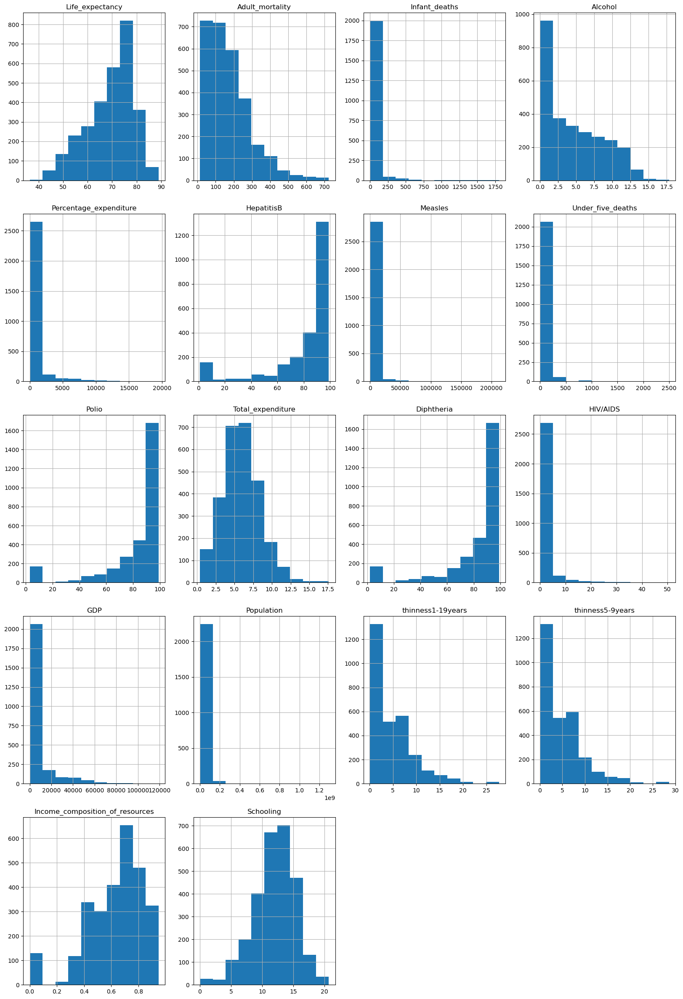

In [26]:
#ploting histogram to view distribution of data  
col_dict = {'Life_expectancy':1,'Adult_mortality':2,'Infant_deaths':3,'Alcohol':4,'Percentage_expenditure':5,'HepatitisB':6,'Measles':7,'Under_five_deaths':8,'Polio':9,'Total_expenditure':10,'Diphtheria':11,'HIV/AIDS':12,'GDP':13,'Population':14,'thinness1-19years':15,'thinness5-9years':16,'Income_composition_of_resources':17,'Schooling':18}

fig = plt.figure(figsize=(20,30)) 

for variable,i in col_dict.items():
                     plt.subplot(5,4,i)
                     plt.hist(life_data[variable])
                     plt.title(variable)
                     plt.grid(True)
    
plt.show()

In [27]:
#filling missing value with median 
imputed_data = []
for year in list(life_data.Year.unique()):
    year_data = life_data[life_data.Year == year].copy()
    for col in list(year_data.columns)[4:]:
        year_data[col] = year_data[col].fillna(year_data[col].dropna().median()).copy()
    imputed_data.append(year_data)
life_data = pd.concat(imputed_data).copy()

#checking for null values 
print(life_data.isnull().sum())

Country                            0
Year                               0
Status                             0
Life_expectancy                    0
Adult_mortality                    0
Infant_deaths                      0
Alcohol                            0
Percentage_expenditure             0
HepatitisB                         0
Measles                            0
Under_five_deaths                  0
Polio                              0
Total_expenditure                  0
Diphtheria                         0
HIV/AIDS                           0
GDP                                0
Population                         0
thinness1-19years                  0
thinness5-9years                   0
Income_composition_of_resources    0
Schooling                          0
dtype: int64


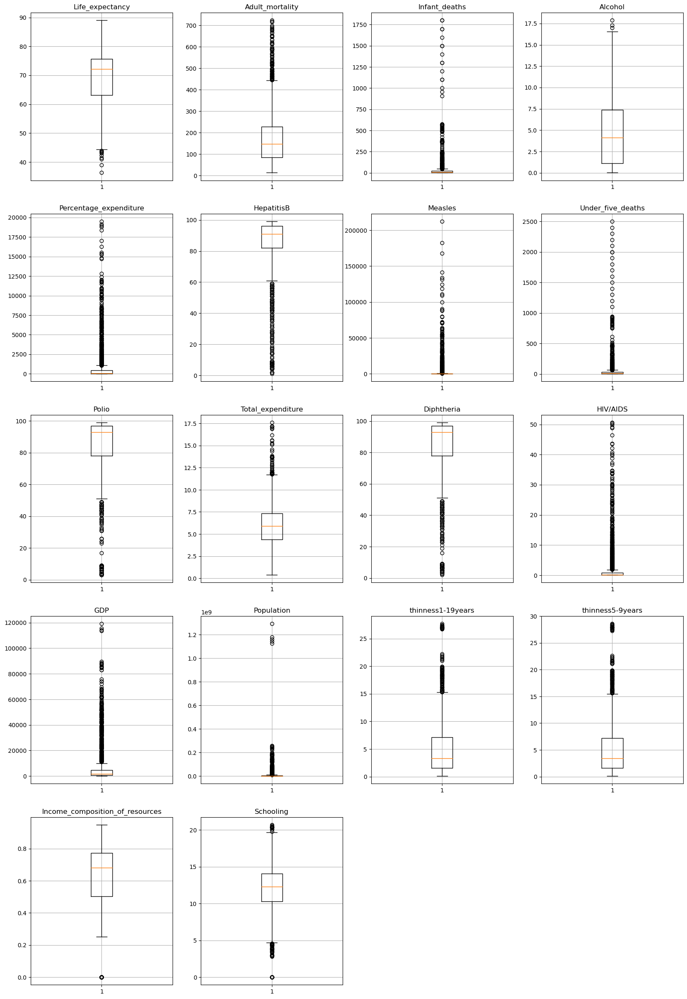

In [28]:
#ploting boxplot to check for outliers 
col_dict = {'Life_expectancy':1,'Adult_mortality':2,'Infant_deaths':3,'Alcohol':4,'Percentage_expenditure':5,'HepatitisB':6,'Measles':7,'Under_five_deaths':8,'Polio':9,'Total_expenditure':10,'Diphtheria':11,'HIV/AIDS':12,'GDP':13,'Population':14,'thinness1-19years':15,'thinness5-9years':16,'Income_composition_of_resources':17,'Schooling':18}

n_vars = len(col_dict)
n_cols = 4
n_rows = math.ceil(n_vars/n_cols)

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20,30))

#iterating over the dictionary 
for i, variable in enumerate(col_dict.keys()):
    row = i // n_cols
    col = i % n_cols
    axes[row, col].boxplot(life_data[variable])
    axes[row, col].set_title(variable)
    axes[row, col].grid(True)

# Checking if last row of subplots is completely filled, and removing extra subplots if necessary
if n_vars % n_cols != 0:
    for i in range(n_cols - (n_vars % n_cols)):
        fig.delaxes(axes[-1,-1-i])

plt.show()

In [32]:
#Remove outliers based using square root transformation 

# select the columns to transform
columns_to_transform = ['Life_expectancy', 'Adult_mortality','Infant_deaths','Alcohol','Percentage_expenditure','HepatitisB','Measles','Under_five_deaths','Polio','Total_expenditure','Diphtheria','HIV/AIDS','GDP','Population',
        'thinness1-19years','thinness5-9years','Income_composition_of_resources','Schooling'] 

# create a copy of the original dataframe with only the columns to transform
life_data_transformed = life_data[columns_to_transform].apply(lambda x: np.square(x), axis=1)
life_data_transformed.columns = [f"square_{col}" for col in columns_to_transform]

# concatenate the square-transformed columns with the original dataframe
sq_df = pd.concat([life_data, life_data_transformed], axis=1)

# print the result
sq_df.head()

,Country,Year,Status,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling,square_Life_expectancy,square_Adult_mortality,square_Infant_deaths,square_Alcohol,square_Percentage_expenditure,square_HepatitisB,square_Measles,square_Under_five_deaths,square_Polio,square_Total_expenditure,square_Diphtheria,square_HIV/AIDS,square_GDP,square_Population,square_thinness1-19years,square_thinness5-9years,square_Income_composition_of_resources,square_Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62.0,0.010,71.279624,65.0,1154,83.0,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,4225.00,69169.0,3844.0,0.000100,5080.784743,4225.0,1331716.0,6889.0,36.0,66.5856,4225.0,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01
16,Albania,2015,Developing,77.8,74.0,8.0,4.600,364.975229,99.0,0,10.0,99.0,6.00,99.0,0.1,3954.227830,28873.0,1.2,1.3,0.762,14.2,6052.84,5476.0,64.0,21.160000,133206.917565,9801.0,0.0,100.0,9801.0,36.0000,9801.0,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64
32,Algeria,2015,Developing,75.6,19.0,21.0,5.285,0.000000,95.0,63,24.0,95.0,7.08,95.0,0.1,4132.762920,39871528.0,6.0,5.8,0.743,14.4,5715.36,361.0,441.0,27.931225,0.000000,9025.0,3969.0,576.0,9025.0,50.1264,9025.0,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36
48,Angola,2015,Developing,52.4,335.0,66.0,5.285,0.000000,64.0,118,98.0,7.0,7.08,64.0,1.9,3695.793748,2785935.0,8.3,8.2,0.531,11.4,2745.76,112225.0,4356.0,27.931225,0.000000,4096.0,13924.0,9604.0,49.0,50.1264,4096.0,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96
64,Antigua and Barbuda,2015,Developing,76.4,13.0,8.0,5.285,0.000000,99.0,0,10.0,86.0,7.08,99.0,0.2,13566.954100,2076086.0,3.3,3.3,0.784,13.9,5836.96,169.0,64.0,27.931225,0.000000,9801.0,0.0,100.0,7396.0,50.1264,9801.0,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21


In [33]:
#dropping extra columns
columns_to_drop = sq_df.columns[sq_df.columns.get_loc("Country"):sq_df.columns.get_loc("Schooling")+1]

# drop the selected columns
sq_df = sq_df.drop(columns=columns_to_drop)
sq_df.shape

(2928, 18)

In [34]:
#adding columns
sq_df['Country'] = life_data['Country']
sq_df['Year'] = life_data['Year']
sq_df['Status'] = life_data['Status']
sq_df.head()

,square_Life_expectancy,square_Adult_mortality,square_Infant_deaths,square_Alcohol,square_Percentage_expenditure,square_HepatitisB,square_Measles,square_Under_five_deaths,square_Polio,square_Total_expenditure,square_Diphtheria,square_HIV/AIDS,square_GDP,square_Population,square_thinness1-19years,square_thinness5-9years,square_Income_composition_of_resources,square_Schooling,Country,Year,Status
0,4225.00,69169.0,3844.0,0.000100,5080.784743,4225.0,1331716.0,6889.0,36.0,66.5856,4225.0,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01,Afghanistan,2015,Developing
16,6052.84,5476.0,64.0,21.160000,133206.917565,9801.0,0.0,100.0,9801.0,36.0000,9801.0,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64,Albania,2015,Developing
32,5715.36,361.0,441.0,27.931225,0.000000,9025.0,3969.0,576.0,9025.0,50.1264,9025.0,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36,Algeria,2015,Developing
48,2745.76,112225.0,4356.0,27.931225,0.000000,4096.0,13924.0,9604.0,49.0,50.1264,4096.0,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96,Angola,2015,Developing
64,5836.96,169.0,64.0,27.931225,0.000000,9801.0,0.0,100.0,7396.0,50.1264,9801.0,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21,Antigua and Barbuda,2015,Developing


In [35]:
sq_df.columns

Index(['square_Life_expectancy', 'square_Adult_mortality',
       'square_Infant_deaths', 'square_Alcohol',
       'square_Percentage_expenditure', 'square_HepatitisB', 'square_Measles',
       'square_Under_five_deaths', 'square_Polio', 'square_Total_expenditure',
       'square_Diphtheria', 'square_HIV/AIDS', 'square_GDP',
       'square_Population', 'square_thinness1-19years',
       'square_thinness5-9years', 'square_Income_composition_of_resources',
       'square_Schooling', 'Country', 'Year', 'Status'],
      dtype='object')

In [36]:
#renaming columns
sq_df.rename(columns = { "square_Life_expectancy": "Life_expectancy", 
                                  "square_Alcohol":"Alcohol", 
                                  "square_Polio":"Polio", 
                                  "square_Under_five_deaths":"Under_five_deaths",
                                  "square_Total_expenditure":"Total_expenditure",
                                  "square_GDP":"GDP",
                                  "square_Population":"Population",
                                  "square_Schooling":"Schooling",
                                  "square_Adult_mortality":"Adult_mortality",
                                  "square_Infant_deaths":"Infant_deaths",
                                  "square_Percentage_expenditure":"Percentage_expenditure",
                                  "square_HepatitisB":"HepatitisB",
                                  "square_Measles":"Measles",
                                  "square_under-five deaths": "Under_five_deaths",
                                  "square_Total expenditure":"Total_expenditure",
                                  "square_Diphtheria": "Diphtheria",
                                  "square_thinness1-19years":"thinness1-19years",
                                  "square_thinness5-9years":"thinness5-9years",
                                  "square_HIV/AIDS":"HIV/AIDS",
                                  "square_Income_composition_of_resources":"Income_composition_of_resources"}, inplace = True)

In [37]:
sq_df.head()

,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling,Country,Year,Status
0,4225.00,69169.0,3844.0,0.000100,5080.784743,4225.0,1331716.0,6889.0,36.0,66.5856,4225.0,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01,Afghanistan,2015,Developing
16,6052.84,5476.0,64.0,21.160000,133206.917565,9801.0,0.0,100.0,9801.0,36.0000,9801.0,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64,Albania,2015,Developing
32,5715.36,361.0,441.0,27.931225,0.000000,9025.0,3969.0,576.0,9025.0,50.1264,9025.0,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36,Algeria,2015,Developing
48,2745.76,112225.0,4356.0,27.931225,0.000000,4096.0,13924.0,9604.0,49.0,50.1264,4096.0,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96,Angola,2015,Developing
64,5836.96,169.0,64.0,27.931225,0.000000,9801.0,0.0,100.0,7396.0,50.1264,9801.0,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21,Antigua and Barbuda,2015,Developing


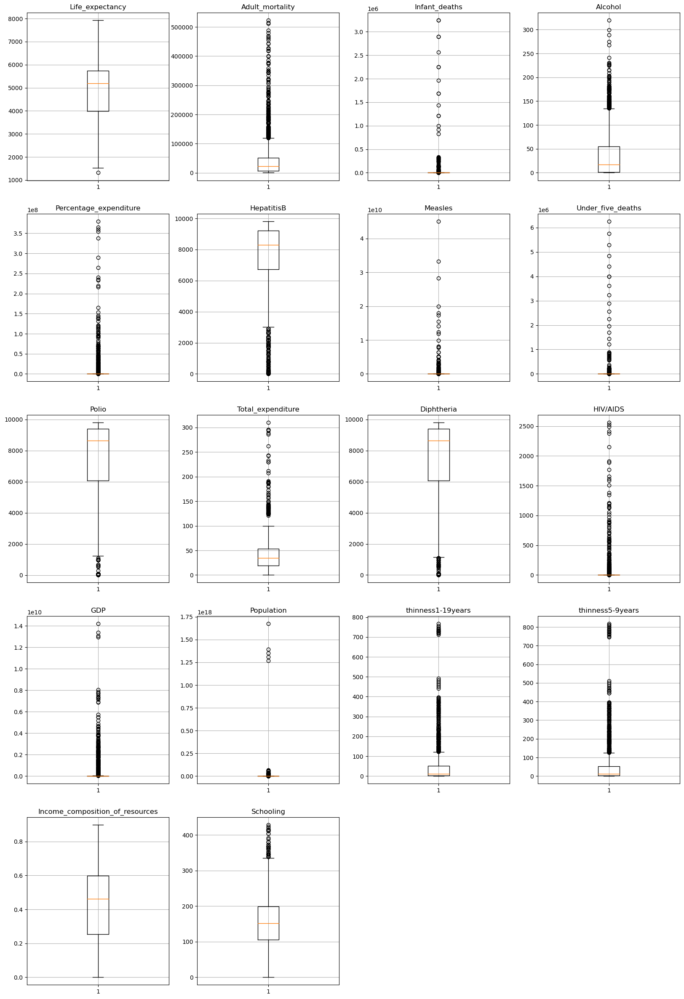

In [38]:
col_dict2 = {'Life_expectancy':1,'Adult_mortality':2,'Infant_deaths':3,'Alcohol':4,
            'Percentage_expenditure':5,'HepatitisB':6,'Measles':7,'Under_five_deaths':8,'Polio':9,
            'Total_expenditure':10,'Diphtheria':11,'HIV/AIDS':12,'GDP':13,'Population':14,
            'thinness1-19years':15,'thinness5-9years':16,'Income_composition_of_resources':17,
            'Schooling':18}

n_vars = len(col_dict)
n_cols = 4
n_rows = math.ceil(n_vars/n_cols)

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20,30))

for i, variable in enumerate(col_dict2.keys()):
    row = i // n_cols
    col = i % n_cols
    axes[row, col].boxplot(sq_df[variable])
    axes[row, col].set_title(variable)
    axes[row, col].grid(True)

# Check if last row of subplots is completely filled, and remove extra subplots if necessary
if n_vars % n_cols != 0:
    for i in range(n_cols - (n_vars % n_cols)):
        fig.delaxes(axes[-1,-1-i])

plt.show()

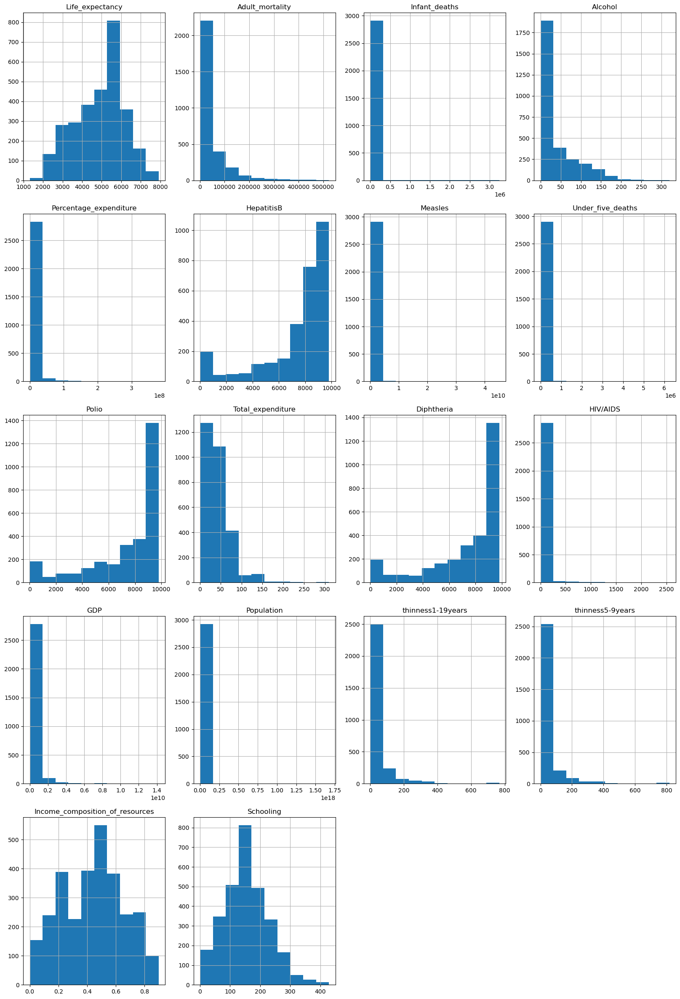

In [39]:
#ploting histogram to distribution 
col_dict2 = {'Life_expectancy':1,'Adult_mortality':2,'Infant_deaths':3,'Alcohol':4,
            'Percentage_expenditure':5,'HepatitisB':6,'Measles':7,'Under_five_deaths':8,'Polio':9,
            'Total_expenditure':10,'Diphtheria':11,'HIV/AIDS':12,'GDP':13,'Population':14,
            'thinness1-19years':15,'thinness5-9years':16,'Income_composition_of_resources':17,
            'Schooling':18}


fig = plt.figure(figsize=(20,30))

for variable,i in col_dict2.items():
                     plt.subplot(5,4,i)
                     plt.hist(sq_df[variable])
                     plt.title(variable)
                     plt.grid(True)
    
plt.show()

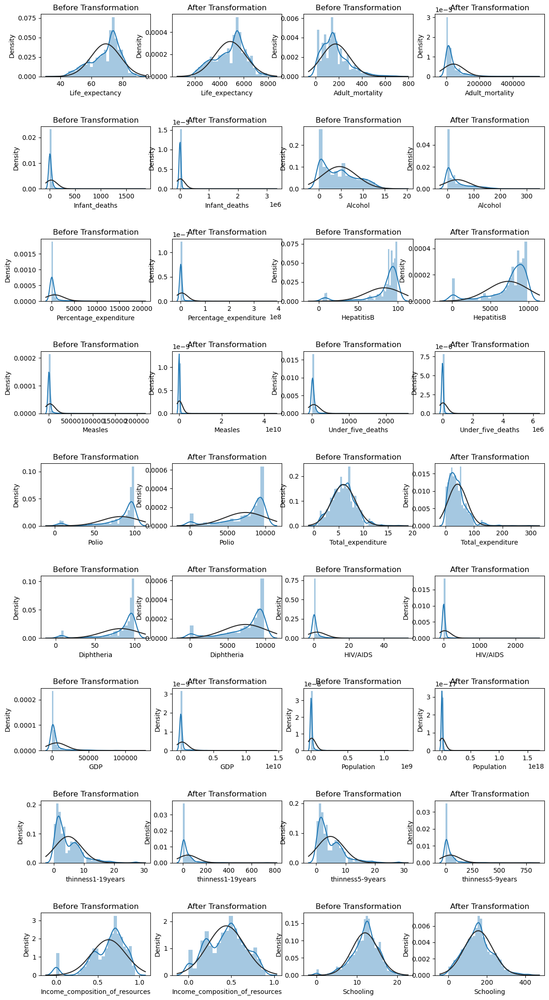

In [40]:
columns = ['Life_expectancy','Adult_mortality','Infant_deaths','Alcohol','Percentage_expenditure','HepatitisB','Measles','Under_five_deaths','Polio','Total_expenditure','Diphtheria','HIV/AIDS','GDP','Population','thinness1-19years','thinness5-9years','Income_composition_of_resources','Schooling']
col_sq = ['Life_expectancy','Adult_mortality','Infant_deaths','Alcohol','Percentage_expenditure','HepatitisB','Measles','Under_five_deaths','Polio','Total_expenditure','Diphtheria','HIV/AIDS','GDP','Population','thinness1-19years','thinness5-9years','Income_composition_of_resources','Schooling']

plt.figure(figsize = (14, 30))
counter = 0
for i in range(len(columns)):
    counter += 1
    plt.subplot(10, 4, counter)
    sns.distplot(life_data[columns[i]], fit=norm)
    plt.subplots_adjust(hspace = 0.8)
    plt.title('Before Transformation')
    counter += 1
    plt.subplot(10, 4, counter)
    sns.distplot(sq_df[col_sq[i]], fit=norm);
    plt.subplots_adjust(hspace = 0.8)
    plt.title('After Transformation')

In [40]:
sq_df.skew()

Life_expectancy                    -0.348076
Adult_mortality                     3.304676
Infant_deaths                      15.622401
Alcohol                             1.625760
Percentage_expenditure              9.590561
HepatitisB                         -1.569091
Measles                            19.449693
Under_five_deaths                  15.558776
Polio                              -1.358190
Total_expenditure                   2.346431
Diphtheria                         -1.374986
HIV/AIDS                            9.562324
GDP                                 7.889614
Population                         24.375617
thinness1-19years                   4.599234
thinness5-9years                    4.747843
Income_composition_of_resources    -0.113286
Schooling                           0.414292
Year                                0.000000
dtype: float64

In [41]:
life_data.skew()

Year                                0.000000
Life_expectancy                    -0.638605
Adult_mortality                     1.268225
Infant_deaths                       9.859003
Alcohol                             0.578455
Percentage_expenditure              4.643790
HepatitisB                         -2.275708
Measles                             9.425290
Under_five_deaths                   9.551395
Polio                              -2.108664
Total_expenditure                   0.510657
Diphtheria                         -2.083034
HIV/AIDS                            5.386623
GDP                                 3.536134
Population                         17.944192
thinness1-19years                   1.727541
thinness5-9years                    1.793747
Income_composition_of_resources    -1.204302
Schooling                          -0.616186
dtype: float64

Text(0.5, 1.0, 'Skewness after Sqaure Root Transformation ')

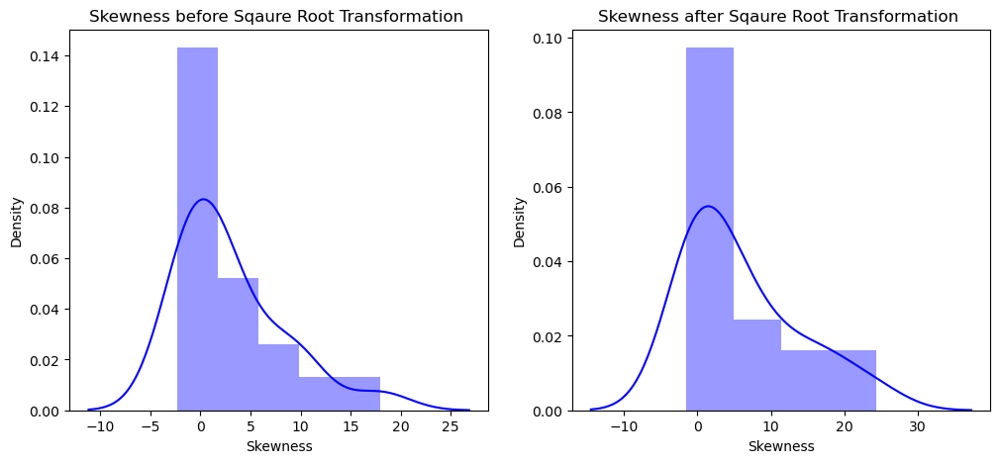

In [42]:
plt.figure(figsize = (12, 5))
plt.subplot(1, 2, 1)
sns.distplot(life_data.skew(),color='blue',axlabel ='Skewness')
plt.title('Skewness before Sqaure Root Transformation ')
plt.subplot(1, 2, 2)
sns.distplot(sq_df.skew(),color='blue',axlabel ='Skewness')
plt.title('Skewness after Sqaure Root Transformation ')

In [43]:
life_data.kurt()

Year                                -1.209428
Life_expectancy                     -0.234477
Adult_mortality                      2.154486
Infant_deaths                      117.235835
Alcohol                             -0.680818
Percentage_expenditure              26.475829
HepatitisB                           4.427364
Measles                            114.467979
Under_five_deaths                  110.646134
Polio                                3.830399
Total_expenditure                    1.150874
Diphtheria                           3.609712
HIV/AIDS                            34.766398
GDP                                 15.094412
Population                         379.893742
thinness1-19years                    4.051046
thinness5-9years                     4.443453
Income_composition_of_resources      1.660375
Schooling                            1.059643
dtype: float64

In [44]:
sq_df.kurt()

Life_expectancy                     -0.513909
Adult_mortality                     14.532066
Infant_deaths                      265.812167
Alcohol                              2.486281
Percentage_expenditure             115.287643
HepatitisB                           1.545548
Measles                            464.189897
Under_five_deaths                  267.866941
Polio                                0.829858
Total_expenditure                   10.705942
Diphtheria                           0.853016
HIV/AIDS                           106.955111
GDP                                 86.327440
Population                         602.862281
thinness1-19years                   28.715360
thinness5-9years                    30.251575
Income_composition_of_resources     -0.753787
Schooling                            0.295033
Year                                -1.209428
dtype: float64

Text(0.5, 1.0, 'Kurtosis after Square Root Transformation ')

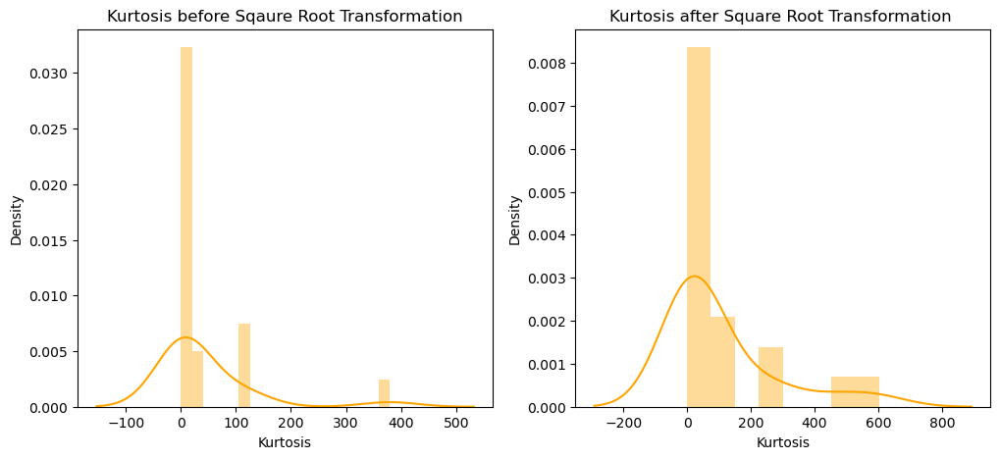

In [45]:
plt.figure(figsize = (12, 5))
plt.subplot(1, 2, 1)
sns.distplot(life_data.kurt(),color='orange',axlabel ='Kurtosis')
plt.title('Kurtosis before Sqaure Root Transformation')
plt.subplot(1, 2, 2)
sns.distplot(sq_df.kurt(),color='orange',axlabel ='Kurtosis')
plt.title('Kurtosis after Square Root Transformation ')

In [46]:
#calculating correlation matrix
sq_cor_mx = sq_df.corr()
sq_cor_mx

,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling,Year
Life_expectancy,1.000000,-0.665198,-0.065074,0.401284,0.263915,0.236972,-0.092526,-0.074356,0.533928,0.244845,0.542827,-0.318645,0.313289,-0.021424,-0.302219,-0.290501,0.797415,0.748135,0.167344
Adult_mortality,-0.665198,1.000000,-0.002742,-0.164755,-0.107204,-0.158386,0.002357,0.001738,-0.290997,-0.069280,-0.291320,0.517032,-0.136005,-0.013275,0.138221,0.135524,-0.437633,-0.371806,-0.105224
Infant_deaths,-0.065074,-0.002742,1.000000,-0.047921,-0.017865,-0.110777,0.173642,0.996966,-0.103521,-0.063173,-0.105035,-0.013076,-0.023341,0.508003,0.597690,0.605859,-0.070278,-0.083172,-0.033046
Alcohol,0.401284,-0.164755,-0.047921,1.000000,0.233861,0.104180,-0.006500,-0.043410,0.240724,0.251295,0.245523,-0.042826,0.220265,-0.029030,-0.258480,-0.248380,0.483116,0.515369,-0.041066
Percentage_expenditure,0.263915,-0.107204,-0.017865,0.233861,1.000000,0.034875,-0.016963,-0.018381,0.102146,0.169332,0.104372,-0.031298,0.860270,-0.009110,-0.092376,-0.090377,0.310327,0.275898,0.046812
HepatitisB,0.236972,-0.158386,-0.110777,0.104180,0.034875,1.000000,-0.026201,-0.113635,0.485537,0.056060,0.534844,-0.069256,0.067003,-0.093150,-0.143545,-0.141242,0.216964,0.205822,0.064192
Measles,-0.092526,0.002357,0.173642,-0.006500,-0.016963,-0.026201,1.000000,0.191485,-0.096779,-0.063121,-0.101495,-0.004798,-0.022180,0.097211,0.134784,0.130489,-0.070335,-0.063135,-0.045171
Under_five_deaths,-0.074356,0.001738,0.996966,-0.043410,-0.018381,-0.113635,0.191485,1.000000,-0.112657,-0.065360,-0.115455,-0.012523,-0.024020,0.494208,0.591827,0.599525,-0.076134,-0.087388,-0.035978
Polio,0.533928,-0.290997,-0.103521,0.240724,0.102146,0.485537,-0.096779,-0.112657,1.000000,0.138115,0.799095,-0.064068,0.141154,-0.041123,-0.211717,-0.208214,0.465793,0.444993,0.107095
Total_expenditure,0.244845,-0.069280,-0.063173,0.251295,0.169332,0.056060,-0.063121,-0.065360,0.138115,1.000000,0.158691,0.004211,0.118379,-0.032252,-0.168584,-0.167904,0.206967,0.269710,0.125501


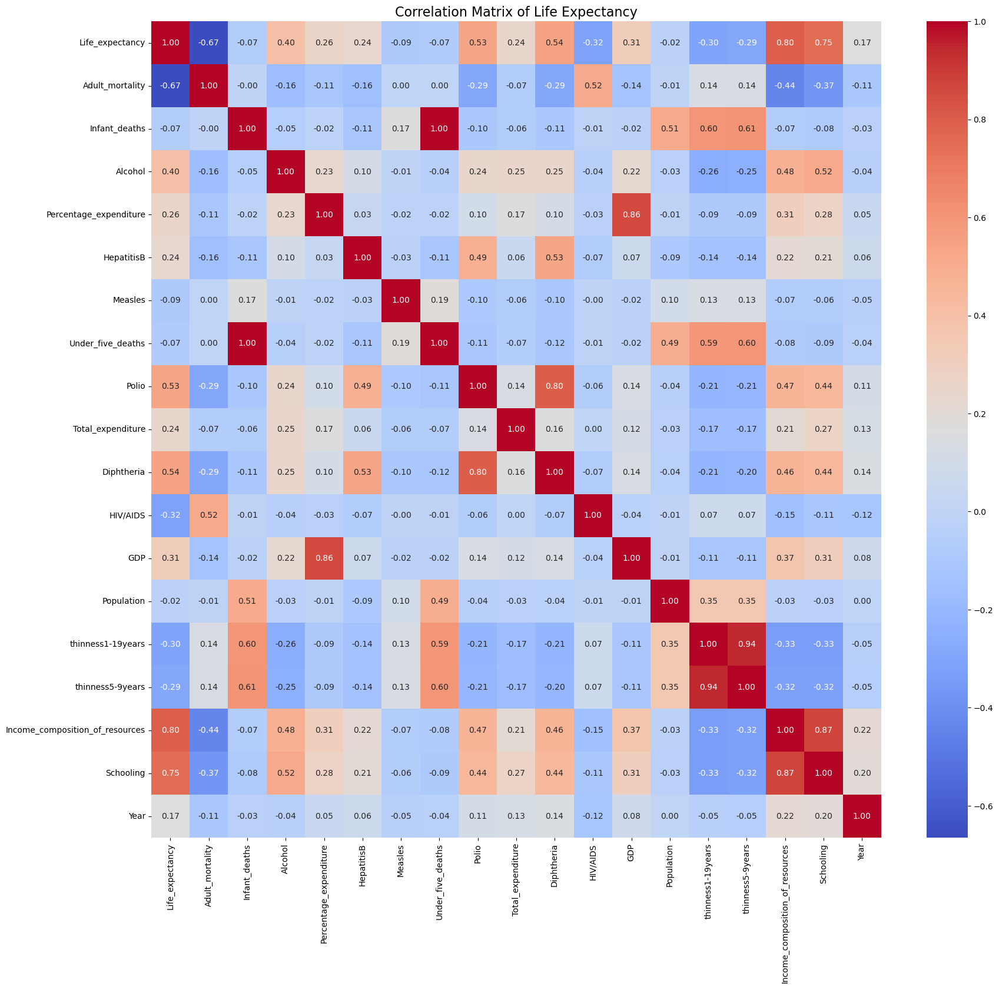

In [47]:
# Set figure size
plt.figure(figsize=(20, 18))

# Plotting the correlation matrix as a heatmap
ax = sns.heatmap(sq_cor_mx, annot=True, cmap='coolwarm', fmt='.2f')

# Add title to the heatmap
ax.set_title('Correlation Matrix of Life Expectancy', fontsize=16)

# Display the plot
plt.show()

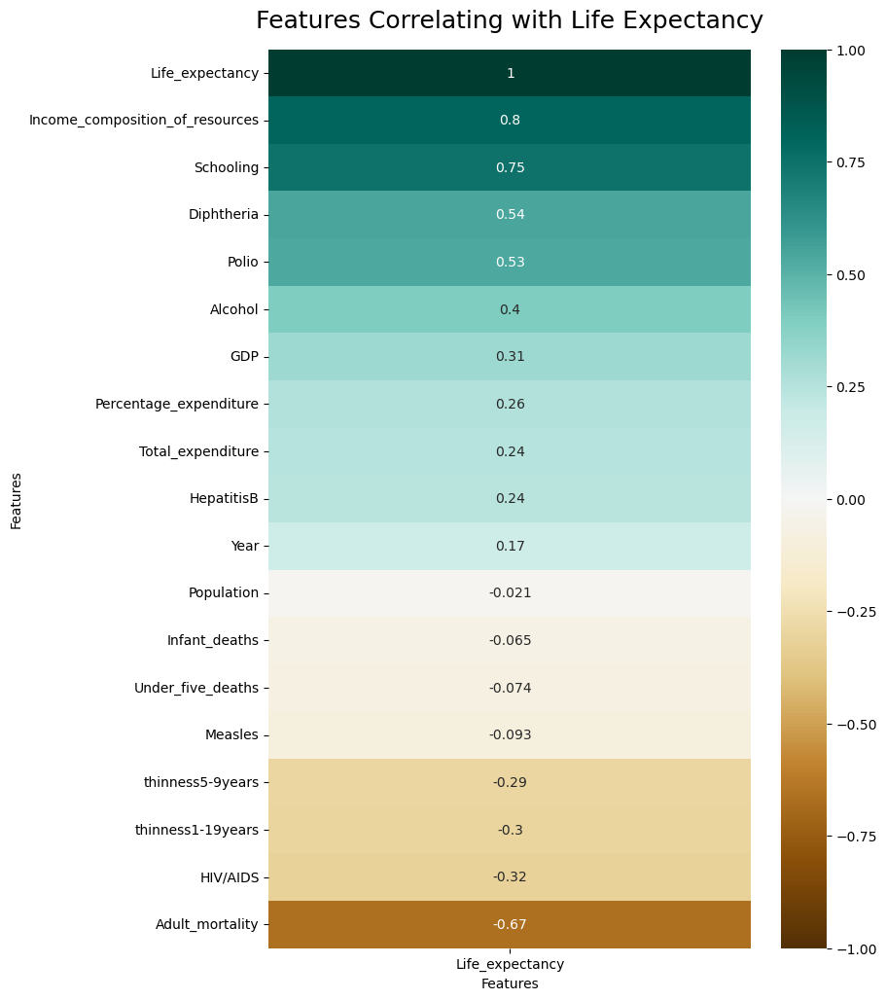

In [48]:
# Calculate the correlation matrix
corr_mx = sq_df.corr()

# Sort the correlations with 'Life Expectancy'
corr_sorted = corr_mx[['Life_expectancy']].sort_values(by='Life_expectancy', ascending=False)

# Create the heatmap
plt.figure(figsize=(8, 12))
heatmap = sns.heatmap(corr_sorted, vmin=-1, vmax=1, annot=True, cmap='BrBG')

# Set the title and axis labels
heatmap.set_title('Features Correlating with Life Expectancy', fontdict={'fontsize':18}, pad=16)
heatmap.set_xlabel('Features')
heatmap.set_ylabel('Features')

# Show the plot
plt.show()

In [49]:
cov_matrix = sq_df.cov()

print("Covariance matrix is:\n")
cov_matrix

Covariance matrix is:



,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling,Year
Life_expectancy,1.600505e+06,-5.312875e+07,-1.298072e+07,2.427857e+04,7.926789e+09,7.954996e+05,-1.722239e+11,-2.676424e+07,1.880152e+06,1.029489e+04,1.924669e+06,-6.959941e+04,3.518980e+11,-1.576977e+18,-3.179235e+04,-3.218161e+04,2.194779e+02,6.987590e+04,9.760938e+02
Adult_mortality,-5.312875e+07,3.985665e+09,-2.729486e+07,-4.974307e+05,-1.606808e+11,-2.653272e+07,2.189341e+11,3.122237e+07,-5.113522e+07,-1.453661e+05,-5.154508e+07,5.635557e+06,-7.623377e+12,-4.876152e+19,7.256008e+05,7.491984e+05,-6.010883e+03,-1.732948e+06,-3.062798e+04
Infant_deaths,-1.298072e+07,-2.729486e+07,2.486105e+10,-3.613534e+05,-6.687683e+10,-4.634720e+07,4.028227e+13,4.472486e+10,-4.543273e+07,-3.310512e+05,-4.641502e+07,-3.559507e+05,-3.267598e+12,4.660332e+21,7.836246e+06,8.364930e+06,-2.410770e+03,-9.681735e+05,-2.402321e+04
Alcohol,2.427857e+04,-4.974307e+05,-3.613534e+05,2.287098e+03,2.655241e+08,1.322026e+04,-4.573312e+08,-5.906632e+05,3.204372e+04,3.994180e+02,3.290789e+04,-3.536053e+02,9.352564e+09,-8.077519e+16,-1.027879e+03,-1.040135e+03,5.026563e+00,1.819615e+03,-9.054795e+00
Percentage_expenditure,7.926789e+09,-1.606808e+11,-6.687683e+10,2.655241e+08,5.636488e+14,2.196995e+09,-5.925347e+14,-1.241604e+11,6.750068e+09,1.336116e+08,6.944686e+09,-1.282887e+08,1.813352e+16,-1.258345e+22,-1.823620e+08,-1.878855e+08,1.602881e+06,4.835831e+08,5.124110e+06
HepatitisB,7.954996e+05,-2.653272e+07,-4.634720e+07,1.322026e+04,2.196995e+09,7.040928e+06,-1.022884e+11,-8.579021e+07,3.586077e+06,4.943922e+03,3.977481e+06,-3.172800e+04,1.578530e+11,-1.438092e+19,-3.167207e+04,-3.281779e+04,1.252507e+02,4.032040e+04,7.853309e+02
Measles,-1.722239e+11,2.189341e+11,4.028227e+13,-4.573312e+08,-5.925347e+14,-1.022884e+11,2.164700e+18,8.015711e+13,-3.963358e+11,-3.086552e+09,-4.185125e+11,-1.218903e+09,-2.897380e+16,8.321600e+24,1.648952e+10,1.681138e+10,-2.251373e+07,-6.857865e+09,-3.064134e+08
Under_five_deaths,-2.676424e+07,3.122237e+07,4.472486e+10,-5.906632e+05,-1.241604e+11,-8.579021e+07,8.015711e+13,8.095016e+10,-8.921699e+07,-6.180502e+05,-9.206384e+07,-6.151699e+05,-6.067608e+12,8.181051e+21,1.400155e+07,1.493646e+07,-4.712674e+03,-1.835605e+06,-4.719529e+04
Polio,1.880152e+06,-5.113522e+07,-4.543273e+07,3.204372e+04,6.750068e+09,3.586077e+06,-3.963358e+11,-8.921699e+07,7.747543e+06,1.277687e+04,6.233706e+06,-3.078896e+04,3.488328e+11,-6.659746e+18,-4.900159e+04,-5.074850e+04,2.820675e+02,9.144374e+04,1.374379e+03
Total_expenditure,1.029489e+04,-1.453661e+05,-3.310512e+05,3.994180e+02,1.336116e+08,4.943922e+03,-3.086552e+09,-6.180502e+05,1.277687e+04,1.104597e+03,1.478153e+04,2.416052e+01,3.493168e+09,-6.236590e+16,-4.658974e+02,-4.886448e+02,1.496518e+00,6.617854e+02,1.923102e+01


In [50]:
# # Set figure size
# plt.figure(figsize=(25, 25))

# # plot covariance matrix as heatmap
# sns.heatmap(cov_matrix, cmap='coolwarm', annot=True, fmt='.2f',annot_kws={"size": 16})
# plt.title("Covariance Matrix of Life Expectancy Data")
# plt.show()

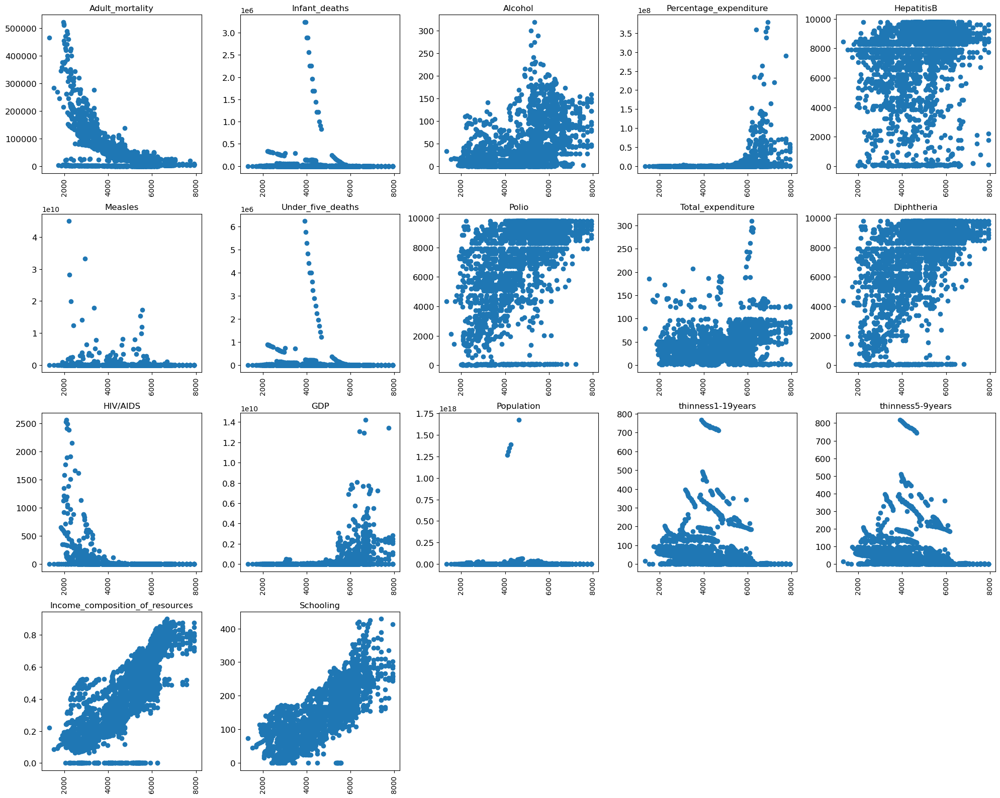

In [51]:
#plotting scatter plot to check each feature relation with the Life expectancy variables
columns = sq_df.columns.drop(['Life_expectancy', 'Country', 'Year', 'Status'])
num_plots = len(columns)
num_rows = num_plots // 5 + 1 if num_plots % 5 != 0 else num_plots // 5
plt.figure(figsize = (20, 4*num_rows))
for i in range(num_plots):
    plt.subplot(num_rows, 5, i + 1)
    plt.scatter(sq_df['Life_expectancy'], sq_df[columns[i]])
    plt.title(columns[i])
    plt.xticks(rotation=90, fontsize= 10)
    plt.yticks(fontsize=12)
# Optional: add a tight layout to prevent overlapping subplots
plt.tight_layout()

In [52]:
fig = px.scatter_matrix(sq_df, dimensions=["Life_expectancy", 'HIV/AIDS', 'thinness1-19years', 'thinness5-9years', 'Infant_deaths', 'Adult_mortality','Under_five_deaths'], color="Status")
fig.update_layout(title="Pairwise Relationships between Health Indicators and Life Expectancy", width=1000, height=1000)
fig.show()


In [53]:
fig = px.scatter_matrix(sq_df, dimensions=["Life_expectancy", 'Percentage_expenditure', 'GDP', 'Population', 'Alcohol', 'Income_composition_of_resources', 'Schooling'], color="Status")
fig.update_layout(title="Pairwise Relationships between Socioeconomic Indicators and Life Expectancy", width=1000, height=1000)
fig.show()

In [54]:
fig = px.scatter_matrix(sq_df, dimensions=['Total_expenditure', 'HepatitisB', 'Polio', 'Diphtheria', 'Measles'], color="Status")
fig.update_layout(title="Pairwise Relationships between Healthcare access and Life Expectancy", width=1000, height=1000)
fig.show()

In [55]:
fig = px.histogram(sq_df, x='Life_expectancy', color_discrete_sequence=['green'], template='plotly_dark', marginal='violin')
fig.update_layout(title='Life Expectancy Distribution', xaxis_title='Life Expectancy', yaxis_title='Count', bargap=0.1)
fig.show()

In [56]:
# Sort the DataFrame by winz_Life_expectancy column in ascending order
sq_df_sorted = sq_df.sort_values('Life_expectancy')

# Creating the plot and setting different colors for the bars based on a categorical variable
fig = px.bar(sq_df_sorted, x='Country', y='Life_expectancy', title='Life Expectancy by Country (ascending)',
             labels={'Country': 'Country', 'Life_expectancy': 'Life Expectancy'},
             hover_name='Country', hover_data={'Life_expectancy': ':.1f'},
             color='Country')

# Customizing the axis labels and title
fig.update_xaxes(title_font=dict(size=18, family='Arial', color='black'))
fig.update_yaxes(title_font=dict(size=18, family='Arial', color='black'))
fig.update_layout(title_font=dict(size=24, family='Arial', color='black'),
                  width=1200, height=800)

# Showing the plot
fig.show()


In [57]:
# Calculate the mean life expectancy for each country
mean_life_expectancy = sq_df.groupby('Country')['Life_expectancy'].mean()

# Sort the data by mean life expectancy
sorted_data = mean_life_expectancy.sort_values(ascending=False)

# Create the bar chart with country as the x-axis and mean life expectancy as the y-axis
fig = px.bar(x=sorted_data.index, y=sorted_data.values, labels={'x': 'Country', 'y': 'Mean Life Expectancy'},
             color=sorted_data.index)

# Customizing the axis labels and title
fig.update_xaxes(title_font=dict(size=18, family='Arial', color='black'))
fig.update_yaxes(title_font=dict(size=18, family='Arial', color='black'))
fig.update_layout(title_font=dict(size=24, family='Arial', color='black'),
                  width=1200, height=800,
                  title={'text': 'Mean Life Expectancy by Country', 'x': 0.5})

# Showing the plot
fig.show()

In [58]:
fig=px.line(sq_df.sort_values(by='Year'),x='Year',y='Life_expectancy',animation_frame='Country',animation_group='Year',color='Country',markers=True,template='plotly_dark',title='<b> Life Expectancy over the Years for Each Country',
           labels={'Country': 'Country', 'Life_expectancy': 'Life Expectancy'},
           hover_name='Country', hover_data={'Life_expectancy': ':.1f'})


fig.show()

In [59]:

# Calculate the mean life expectancy for each country
country_means = sq_df.groupby('Country')['Life_expectancy'].mean().reset_index()

# Create a map graph using Plotly Express
fig = px.choropleth(country_means,
                    locations='Country',
                    locationmode='country names',
                    color='Life_expectancy',
                    color_continuous_scale=px.colors.sequential.Plasma,
                    range_color=(0, 100),
                    title='Mean Life Expectancy by Country')
fig.show()

In [60]:
# Calculate the mean life expectancy for each country
mean_life_expectancy = sq_df.groupby('Country')['Life_expectancy'].mean()

# Sort the data by mean life expectancy and get the top 10 countries
top10 = mean_life_expectancy.sort_values(ascending=False).head(15)

# Create a bar chart with mean life expectancy as the x-axis and country as the y-axis
fig = px.bar(x=top10.values, y=top10.index, orientation='h', labels={'x': 'Mean Life Expectancy', 'y': 'Country'}, 
             color=top10.values, color_continuous_scale='RdBu_r')

# Add a title
fig.update_layout(title_text='Top 15 Countries with the Highest Life Expectancy')

# Show the plot
fig.show()


In [61]:
# Calculate the mean life expectancy for each country
mean_life_expectancy = sq_df.groupby('Country')['Life_expectancy'].mean()

# Sort the data by mean life expectancy and get the top 10 countries
top10 = mean_life_expectancy.sort_values(ascending=True).head(15)

# Create a bar chart with mean life expectancy as the x-axis and country as the y-axis
fig = px.bar(x=top10.values, y=top10.index, orientation='h', labels={'x': 'Mean Life Expectancy', 'y': 'Country'}, 
             color=top10.values, color_continuous_scale='RdBu_r')

# Add a title
fig.update_layout(title_text='Top 15 Countries with the Lowest Life Expectancy')

# Show the plot
fig.show()


In [62]:
sq_df['Life_expectancy'].groupby(sq_df['Status']).describe()

,count,mean,std,min,25%,50%,75%,max
Status,,,,,,,,
Developed,512.0,6287.721816,624.459304,4886.01,5898.24,6280.565,6674.89,7921.0
Developing,2416.0,4585.024888,1161.957059,1317.69,3733.21,4761.000,5476.00,7921.0


<AxesSubplot:xlabel='Status', ylabel='Life_expectancy'>

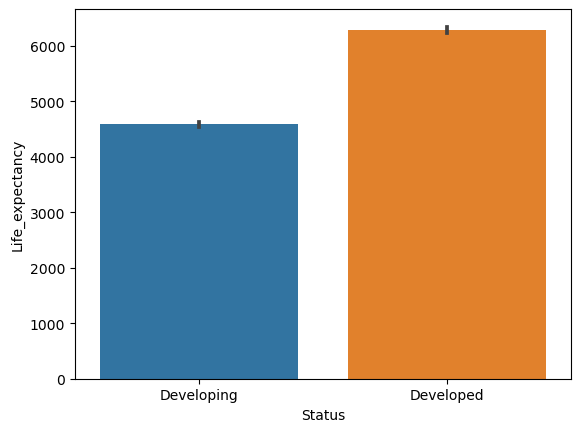

In [63]:
sns.barplot(sq_df["Status"],sq_df["Life_expectancy"])

In [64]:
fig = px.histogram(sq_df, x="Life_expectancy", color="Status", opacity=0.8,
                   title="Life Expectancy by Status",
                   labels={"Life_expectancy": "Life Expectancy", "count": "Density"},
                   template="plotly_dark", nbins=20)
fig.update_layout(xaxis={"title": "Life Expectancy"}, yaxis={"title": "Density"},
                  font=dict(family="Arial", size=12), height=500, width=900)
fig.show()


In [65]:
# Group the data by status and year, and calculate the mean life expectancy for each group
life_expectancy = sq_df.groupby(['Status', 'Year'])['Life_expectancy'].mean().reset_index()

# Create a line plot with year as the x-axis, mean life expectancy as the y-axis, and status as the color
fig = px.line(life_expectancy, x='Year', y='Life_expectancy', color='Status',
              title='Life Expectancy Over Time by Status',
              labels={'Life_expectancy': 'Life Expectancy', 'Year': 'Year'})

# Set the plot size and font
fig.update_layout(width=900, height=500, font=dict(family="Arial", size=12))

# Show the plot
fig.show()

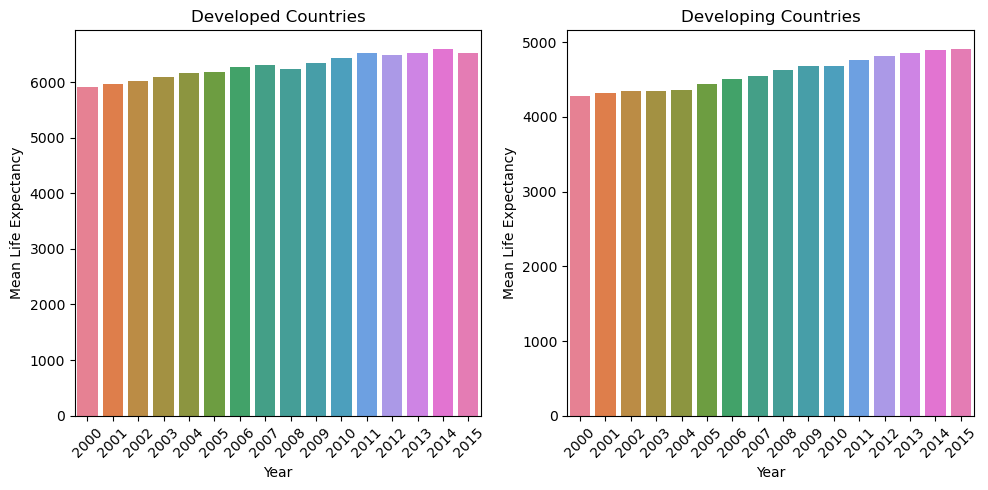

In [66]:
# Subset the data by status
developed = sq_df[sq_df['Status'] == 'Developed']
developing = sq_df[sq_df['Status'] == 'Developing']

# Calculate the mean life expectancy for each year and status
developed_mean_lifexp = developed.groupby('Year')['Life_expectancy'].mean().reset_index()
developing_mean_lifexp = developing.groupby('Year')['Life_expectancy'].mean().reset_index()

# Plot the bar plots side by side with a different color palette
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
ax1 = sns.barplot(x='Year', y='Life_expectancy', data=developed_mean_lifexp, palette='husl')
plt.xticks(rotation=45)
_ = ax1.set(xlabel='Year', ylabel='Mean Life Expectancy', title='Developed Countries')

plt.subplot(1, 2, 2)
ax2 = sns.barplot(x='Year', y='Life_expectancy', data=developing_mean_lifexp, palette='husl')
plt.xticks(rotation=45)
_ = ax2.set(xlabel='Year', ylabel='Mean Life Expectancy', title='Developing Countries')

plt.tight_layout()
plt.show()


In [67]:
# create a list of variables to plot
variables = ["Life_expectancy", 'Percentage_expenditure', 'GDP', 'Population', 'Alcohol', 'Income_composition_of_resources', 'Schooling']

# define colors for Developed and Developing status
colors = {'Developed': 'blue', 'Developing': 'green'}

# loop through the variables and create a bar plot for each one
for var in variables:
    # create a dataframe for the current variable and status
    df_var = sq_df[['Year', var, 'Status']].copy()
    
    # filter the dataframe for Developed and Developing status
    df_developed = df_var[df_var['Status'] == 'Developed']
    df_developing = df_var[df_var['Status'] == 'Developing']
    
    # create a bar plot for Developed status
    fig_developed = px.bar(df_developed, x='Year', y=var, color='Status', title=var + ' (Developed)', color_discrete_map=colors, height=400, width=600)
    fig_developed.show()
    
    # create a bar plot for Developing status
    fig_developing = px.bar(df_developing, x='Year', y=var, color='Status', title=var + ' (Developing)', color_discrete_map=colors, height=400, width=600)
    fig_developing.show()


In [68]:
# create a list of variables to plot
variables = ['Total_expenditure', 'HepatitisB', 'Polio', 'Diphtheria', 'Measles']

# define colors for Developed and Developing status
colors = {'Developed': 'blue', 'Developing': 'green'}

# loop through the variables and create a bar plot for each one
for var in variables:
    # create a dataframe for the current variable and status
    df_var = sq_df[['Year', var, 'Status']].copy()
    
    # filter the dataframe for Developed and Developing status
    df_developed = df_var[df_var['Status'] == 'Developed']
    df_developing = df_var[df_var['Status'] == 'Developing']
    
    # create a bar plot for Developed status
    fig_developed = px.bar(df_developed, x='Year', y=var, color='Status', title=var + ' (Developed)', color_discrete_map=colors, height=400, width=600)
    fig_developed.show()
    
    # create a bar plot for Developing status
    fig_developing = px.bar(df_developing, x='Year', y=var, color='Status', title=var + ' (Developing)', color_discrete_map=colors, height=400, width=600)
    fig_developing.show()

In [69]:
# create a list of variables to plot
variables = ["Life_expectancy", 'HIV/AIDS', 'thinness1-19years', 'thinness5-9years', 'Infant_deaths', 'Adult_mortality','Under_five_deaths']

# define colors for Developed and Developing status
colors = {'Developed': 'blue', 'Developing': 'green'}

# loop through the variables and create a bar plot for each one
for var in variables:
    # create a dataframe for the current variable and status
    df_var = sq_df[['Year', var, 'Status']].copy()
    
    # filter the dataframe for Developed and Developing status
    df_developed = df_var[df_var['Status'] == 'Developed']
    df_developing = df_var[df_var['Status'] == 'Developing']
    
    # create a bar plot for Developed status
    fig_developed = px.bar(df_developed, x='Year', y=var, color='Status', title=var + ' (Developed)', color_discrete_map=colors, height=400, width=600)
    fig_developed.show()
    
    # create a bar plot for Developing status
    fig_developing = px.bar(df_developing, x='Year', y=var, color='Status', title=var + ' (Developing)', color_discrete_map=colors, height=400, width=600)
    fig_developing.show()

In [72]:
# creating a dictionary mapping each country to its corresponding continent for further analysis in Tableau
continent_dict = {
    "Afghanistan": "Asia",
    "Albania": "Europe",
    "Algeria": "Africa",
    "Angola": "Africa",
    "Antigua and Barbuda": "North America",
    "Argentina": "South America",
    "Armenia": "Asia",
    "Australia": "Oceania",
    "Austria": "Europe",
    "Azerbaijan": "Asia",
    "Bahamas": "North America",
    "Bahrain": "Asia",
    "Bangladesh": "Asia",
    "Barbados": "North America",
    "Belarus": "Europe",
    "Belgium": "Europe",
    "Belize": "North America",
    "Benin": "Africa",
    "Bhutan": "Asia",
    "Bolivia (Plurinational State of)": "South America",
    "Bosnia and Herzegovina": "Europe",
    "Botswana": "Africa",
    "Brazil": "South America",
    "Brunei Darussalam": "Asia",
    "Bulgaria": "Europe",
    "Burkina Faso": "Africa",
    "Burundi": "Africa",
    "Cabo Verde": "Africa",
    "Cambodia": "Asia",
    "Cameroon": "Africa",
    "Canada": "North America",
    "Central African Republic": "Africa",
    "Chad": "Africa",
    "Chile": "South America",
    "China": "Asia",
    "Colombia": "South America",
    "Comoros": "Africa",
    "Congo": "Africa",
    "Cook Islands": "Oceania",
    "Costa Rica": "North America",
    "Croatia": "Europe",
    "Cuba": "North America",
    "Cyprus": "Asia",
    "Czechia": "Europe",
    "Côte d'Ivoire": "Africa",
    "Democratic People's Republic of Korea": "Asia",
    "Democratic Republic of the Congo": "Africa",
    "Denmark": "Europe",
    "Djibouti": "Africa",
    "Dominica": "North America",
    "Dominican Republic": "North America",
    "Ecuador": "South America",
    "Egypt": "Africa",
    "El Salvador": "North America",
    "Equatorial Guinea": "Africa",
    "Eritrea": "Africa",
    "Estonia": "Europe",
    "Ethiopia": "Africa",
    "Fiji": "Oceania",
    "Finland": "Europe",
    "France": "Europe",
    "Gabon": "Africa",
    "Gambia": "Africa",
    "Georgia": "Asia",
    "Germany": "Europe",
    "Ghana": "Africa",
    "Greece": "Europe",
    "Grenada": "North America",
    "Guatemala": "North America",
    "Guinea": "Africa",
    "Guinea-Bissau": "Africa",
    "Guyana": "South America",
    "Haiti": "North America",
    "Honduras": "North America",
    "Hungary": "Europe",
    "Iceland": "Europe",
    "India": "Asia",
    "Indonesia": "Asia",
    "Iran (Islamic Republic of)": "Asia",
    "Iraq": "Asia",
    "Ireland": "Europe",
    "Israel": "Asia",
    "Italy": "Europe",
    "Jamaica": "North America",
    "Japan": "Asia",
    "Jordan": "Asia",
    "Kazakhstan": "Asia",
    "Kenya": "Africa",
    "Kiribati": "Oceania",
    "Kuwait": "Asia",
    "Kyrgyzstan": "Asia",
    "Lao People's Democratic Republic": "Asia",
    "Latvia": "Europe",
    "Lebanon": "Asia",
    "Lesotho": "Africa",
    "Liberia": "Africa",
    "Libya": "Africa",
    "Lithuania": "Europe",
    "Luxembourg": "Europe",
    "Madagascar": "Africa",
    "Malawi": "Africa",
    "Malaysia": "Asia",
    "Maldives": "Asia",
    "Mali": "Africa",
    "Malta": "Europe",
    "Marshall Islands": "Oceania",
    "Mauritania": "Africa",
    "Mauritius": "Africa",
    "Mexico": "North America",
    "Micronesia (Federated States of)": "Oceania",
    "Monaco": "Europe",
    "Mongolia": "Asia",
    "Montenegro": "Europe",
    "Morocco": "Africa",
    "Mozambique": "Africa",
    "Myanmar": "Asia",
    "Namibia": "Africa",
    "Nauru": "Oceania",
    "Nepal": "Asia",
    "Netherlands": "Europe",
    "New Zealand": "Oceania",
    "Nicaragua": "North America",
    "Niger": "Africa",
    "Nigeria": "Africa",
    "Niue": "Oceania",
    "Norway": "Europe",
    "Oman": "Asia",
    "Pakistan": "Asia",
    "Palau": "Oceania",
    "Panama": "North America",
    "Papua New Guinea": "Oceania",
    "Paraguay": "South America",
    "Peru": "South America",
    "Philippines": "Asia",
    "Poland": "Europe",
    "Portugal": "Europe",
    "Qatar": "Asia",
    "Republic of Korea": "Asia",
    "Republic of Moldova": "Europe",
    "Romania": "Europe",
    "Russian Federation": "Europe/Asia",
    "Rwanda": "Africa",
    "Saint Kitts and Nevis": "North America",
    "Saint Lucia": "North America",
    "Saint Vincent and the Grenadines": "North America",
    "Samoa": "Oceania",
    "San Marino": "Europe",
    "Sao Tome and Principe": "Africa",
    "Saudi Arabia": "Asia",
    "Senegal": "Africa",
    "Serbia": "Europe",
    "Seychelles": "Africa",
    "Sierra Leone": "Africa",
    "Singapore": "Asia",
    "Slovakia": "Europe",
    "Slovenia": "Europe",
    "Solomon Islands": "Oceania",
    "Somalia": "Africa",
    "South Africa": "Africa",
    "South Sudan": "Africa",
    "Spain": "Europe",
    "Sri Lanka": "Asia",
    "Sudan": "Africa",
    "Suriname": "South America",
    "Swaziland": "Africa",
    "Sweden": "Europe",
    "Switzerland": "Europe",
     "Syrian Arab Republic": "Asia",
     "Tajikistan": "Asia",
     "Thailand": "Asia",
     "The former Yugoslav republic of Macedonia": "Europe",
     "Timor-Leste": "Asia",
     "Togo": "Africa",
     "Tonga": "Oceania",
     "Trinidad and Tobago": "North America",
     "Tunisia": "Africa",
     "Turkey": "Asia/Europe",
     "Turkmenistan": "Asia",
     "Tuvalu": "Oceania",
     "Uganda": "Africa",
     "Ukraine": "Europe",
     "United Arab Emirates": "Asia",
     "United Kingdom of Great Britain and Northern Ireland": "Europe",
     "United Republic of Tanzania": "Africa",
     "United States of America": "North America",
     "Uruguay": "South America",
     "Uzbekistan": "Asia",
     "Vanuatu": "Oceania",
     "Venezuela (Bolivarian Republic of)": "South America",
     "Viet Nam": "Asia",
     "Yemen": "Asia",
     "Zambia": "Africa",
     "Zimbabwe": "Africa"
    
}

# create a new column in the DataFrame for the continent
sq_df['Continent'] = life_data['Country'].map(continent_dict) 

In [73]:
sq_df.head()

,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling,Country,Year,Status,Continent
0,4225.00,69169.0,3844.0,0.000100,5080.784743,4225.0,1331716.0,6889.0,36.0,66.5856,4225.0,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01,Afghanistan,2015,Developing,Asia
16,6052.84,5476.0,64.0,21.160000,133206.917565,9801.0,0.0,100.0,9801.0,36.0000,9801.0,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64,Albania,2015,Developing,Europe
32,5715.36,361.0,441.0,27.931225,0.000000,9025.0,3969.0,576.0,9025.0,50.1264,9025.0,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36,Algeria,2015,Developing,Africa
48,2745.76,112225.0,4356.0,27.931225,0.000000,4096.0,13924.0,9604.0,49.0,50.1264,4096.0,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96,Angola,2015,Developing,Africa
64,5836.96,169.0,64.0,27.931225,0.000000,9801.0,0.0,100.0,7396.0,50.1264,9801.0,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21,Antigua and Barbuda,2015,Developing,North America


In [76]:
# get a list of the column names, re-order the column names as desired
cols = list(sq_df.columns[-4:]) + list(sq_df.columns[:-4])

# re-index the DataFrame with the new column order
sq_df = sq_df.reindex(columns=cols)

# print the updated DataFrame
sq_df.head()

,Country,Year,Status,Continent,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling
0,Afghanistan,2015,Developing,Asia,4225.00,69169.0,3844.0,0.000100,5080.784743,4225.0,1331716.0,6889.0,36.0,66.5856,4225.0,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01
16,Albania,2015,Developing,Europe,6052.84,5476.0,64.0,21.160000,133206.917565,9801.0,0.0,100.0,9801.0,36.0000,9801.0,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64
32,Algeria,2015,Developing,Africa,5715.36,361.0,441.0,27.931225,0.000000,9025.0,3969.0,576.0,9025.0,50.1264,9025.0,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36
48,Angola,2015,Developing,Africa,2745.76,112225.0,4356.0,27.931225,0.000000,4096.0,13924.0,9604.0,49.0,50.1264,4096.0,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96
64,Antigua and Barbuda,2015,Developing,North America,5836.96,169.0,64.0,27.931225,0.000000,9801.0,0.0,100.0,7396.0,50.1264,9801.0,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21


In [77]:
# save the DataFrame to an Excel file for analysis in Tableu
sq_df.to_csv('Exp_data.csv', index=False)

Multiple Linear Regression

In [78]:
sq_df_copy = sq_df.copy()
sq_df_copy

,Country,Year,Status,Continent,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling
0,Afghanistan,2015,Developing,Asia,4225.00,69169.00,3844.00,0.000100,5.080785e+03,4225.0,1.331716e+06,6889.00,36.00,66.585600,4225.00,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01
16,Albania,2015,Developing,Europe,6052.84,5476.00,64.00,21.160000,1.332069e+05,9801.0,0.000000e+00,100.00,9801.00,36.000000,9801.00,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64
32,Algeria,2015,Developing,Africa,5715.36,361.00,441.00,27.931225,0.000000e+00,9025.0,3.969000e+03,576.00,9025.00,50.126400,9025.00,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36
48,Angola,2015,Developing,Africa,2745.76,112225.00,4356.00,27.931225,0.000000e+00,4096.0,1.392400e+04,9604.00,49.00,50.126400,4096.00,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96
64,Antigua and Barbuda,2015,Developing,North America,5836.96,169.00,64.00,27.931225,0.000000e+00,9801.0,0.000000e+00,100.00,7396.00,50.126400,9801.00,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21
80,Argentina,2015,Developing,South America,5821.69,13456.00,64.00,27.931225,0.000000e+00,8836.0,0.000000e+00,81.00,8649.00,50.126400,8836.00,0.01,1.813634e+08,1.885102e+15,1.00,0.81,0.682276,299.29
96,Armenia,2015,Developing,Asia,5595.04,13924.00,1.00,27.931225,0.000000e+00,8836.0,1.089000e+03,1.00,9216.00,50.126400,8836.00,0.01,1.366447e+05,8.508597e+10,4.41,4.84,0.549081,161.29
112,Australia,2015,Developed,Oceania,6855.84,3481.00,1.00,27.931225,0.000000e+00,8649.0,5.476000e+03,1.00,8649.00,50.126400,8649.00,0.01,3.198399e+09,5.659326e+14,0.36,0.36,0.877969,416.16
128,Austria,2015,Developed,Europe,6642.25,4225.00,64.00,27.931225,0.000000e+00,8649.0,9.548100e+04,100.00,8649.00,50.126400,8649.00,0.01,1.906715e+09,7.453161e+13,3.61,4.41,0.795664,252.81
144,Azerbaijan,2015,Developing,Asia,5285.29,13924.00,25.00,27.931225,0.000000e+00,9216.0,0.000000e+00,36.00,9604.00,50.126400,9216.00,0.01,3.059619e+03,9.310978e+13,7.84,8.41,0.574564,161.29


In [79]:
# Remove any unnecessary columns
sq_df_copy = sq_df_copy.drop(['Year', 'Status', 'Continent', 'Country'], axis=1)
sq_df_copy.head()

,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling
0,4225.00,69169.0,3844.0,0.000100,5080.784743,4225.0,1331716.0,6889.0,36.0,66.5856,4225.0,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01
16,6052.84,5476.0,64.0,21.160000,133206.917565,9801.0,0.0,100.0,9801.0,36.0000,9801.0,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64
32,5715.36,361.0,441.0,27.931225,0.000000,9025.0,3969.0,576.0,9025.0,50.1264,9025.0,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36
48,2745.76,112225.0,4356.0,27.931225,0.000000,4096.0,13924.0,9604.0,49.0,50.1264,4096.0,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96
64,5836.96,169.0,64.0,27.931225,0.000000,9801.0,0.0,100.0,7396.0,50.1264,9801.0,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21


In [80]:
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(sq_df_copy)
sq_df_copy = pd.DataFrame(scaled_data, columns=sq_df_copy.columns)

In [81]:
X = sq_df_copy.drop(['Life_expectancy'], axis=1)
y = sq_df_copy['Life_expectancy']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [82]:
model = LinearRegression()
model.fit(X_train, y_train)
print('Intercept:', model.intercept_)
print('Coefficients:', model.coef_)

Intercept: 0.30018448705515977
Coefficients: [-0.56361241  1.34984278  0.01585332 -0.0277602  -0.04478127 -0.11892773
 -1.32247603  0.06537153  0.10302575  0.08078625 -0.19173756  0.16519438
 -0.04551447 -0.09149826  0.00977649  0.25898913  0.20447588]


In [83]:
lm = LinearRegression()
lm.fit(X_train, y_train)
print(f"Train accuracy {round(lm.score(X_train,y_train)*100,2)} %")
print(f"Test accuracy {round(lm.score(X_test,y_test)*100,2)} %")

Train accuracy 81.07 %
Test accuracy 79.68 %


In [84]:
y_pred = model.predict(X_test)
print('R-squared score:', r2_score(y_test, y_pred))
print('Mean squared error:', mean_squared_error(y_test, y_pred))
print('Mean absolute error:', np.mean(np.abs(y_pred - y_test)))

R-squared score: 0.7967537855141362
Mean squared error: 0.007419887925799628
Mean absolute error: 0.06268123148769948


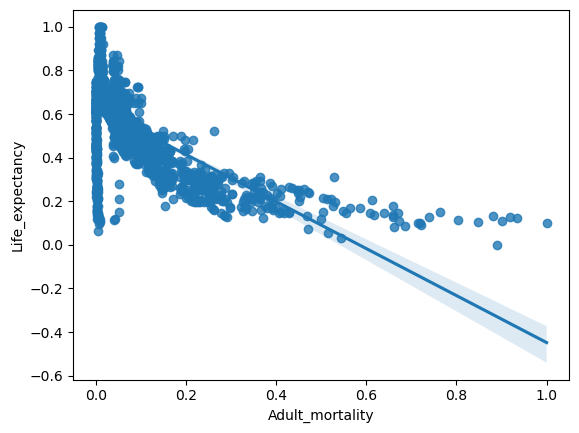

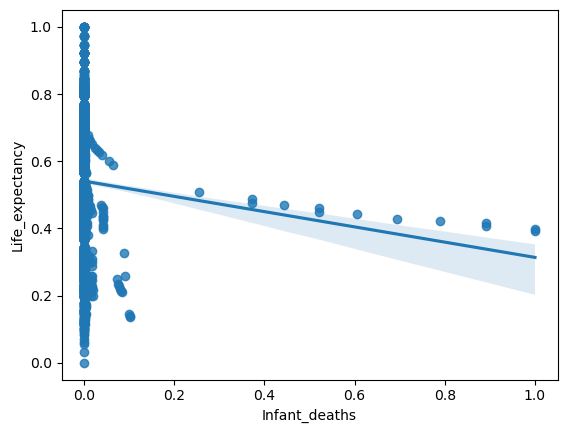

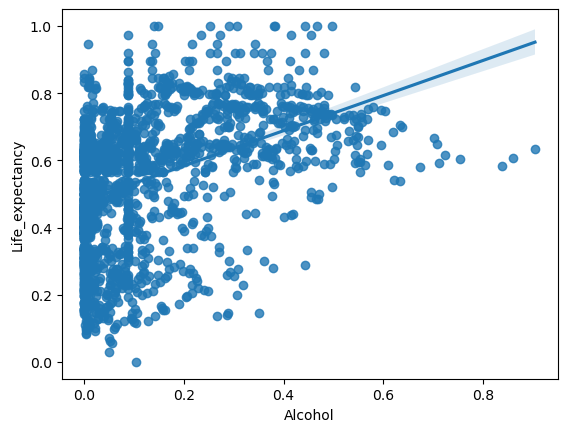

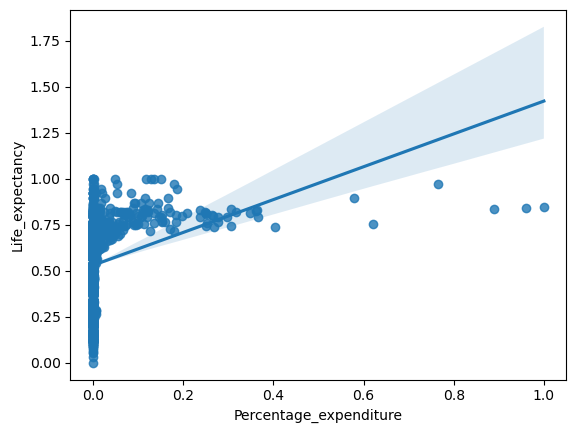

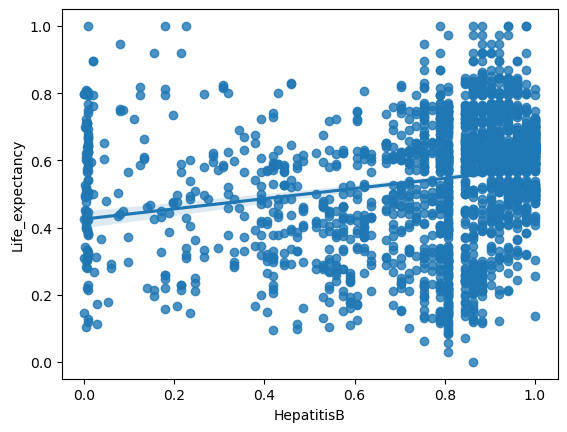

...

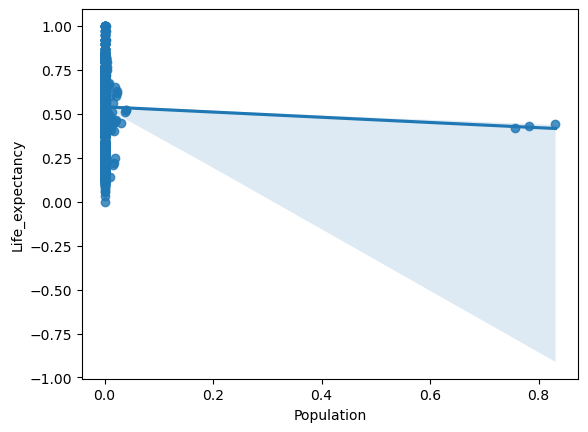

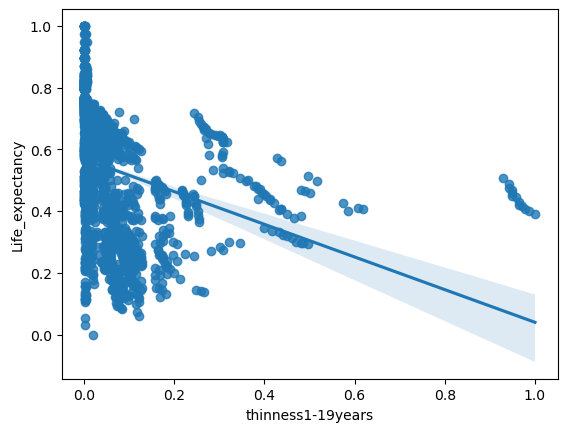

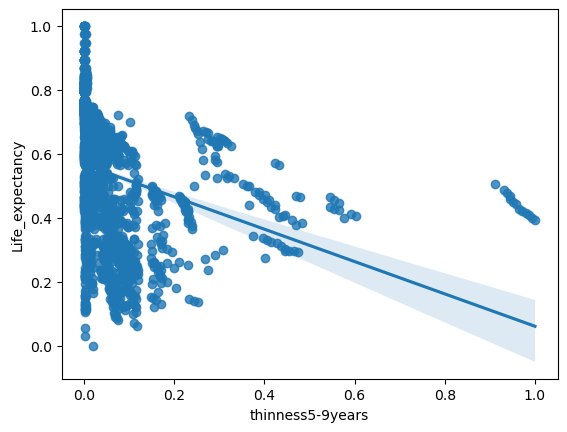

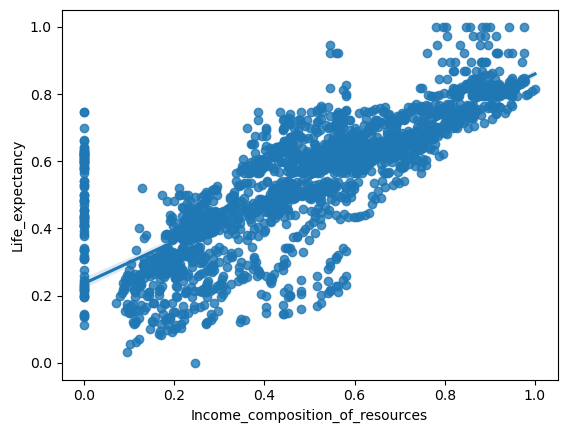

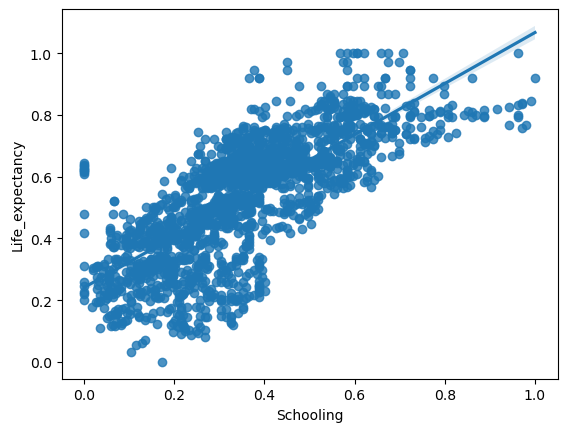

In [85]:
for col in X_train.columns:
    sns.regplot(x=X_train[col], y=y_train)
    plt.xlabel(col)
    plt.ylabel('Life_expectancy')
    plt.show()

<AxesSubplot:xlabel='Life_expectancy'>

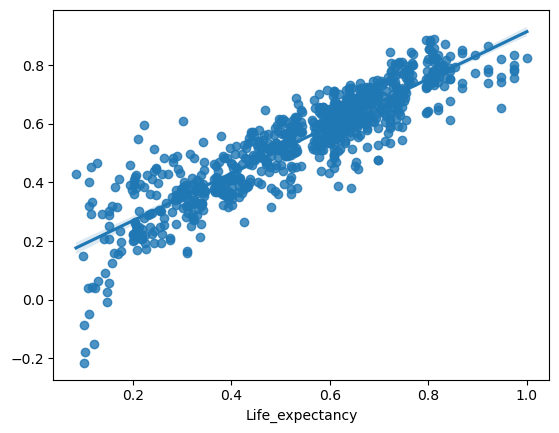

In [86]:
sns.regplot(x =  y_test, y = model.predict(X_test))

Feature Selection

In [87]:
sq_df2= sq_df.copy()
sq_df2

,Country,Year,Status,Continent,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling
0,Afghanistan,2015,Developing,Asia,4225.00,69169.00,3844.00,0.000100,5.080785e+03,4225.0,1.331716e+06,6889.00,36.00,66.585600,4225.00,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01
16,Albania,2015,Developing,Europe,6052.84,5476.00,64.00,21.160000,1.332069e+05,9801.0,0.000000e+00,100.00,9801.00,36.000000,9801.00,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64
32,Algeria,2015,Developing,Africa,5715.36,361.00,441.00,27.931225,0.000000e+00,9025.0,3.969000e+03,576.00,9025.00,50.126400,9025.00,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36
48,Angola,2015,Developing,Africa,2745.76,112225.00,4356.00,27.931225,0.000000e+00,4096.0,1.392400e+04,9604.00,49.00,50.126400,4096.00,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96
64,Antigua and Barbuda,2015,Developing,North America,5836.96,169.00,64.00,27.931225,0.000000e+00,9801.0,0.000000e+00,100.00,7396.00,50.126400,9801.00,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21
80,Argentina,2015,Developing,South America,5821.69,13456.00,64.00,27.931225,0.000000e+00,8836.0,0.000000e+00,81.00,8649.00,50.126400,8836.00,0.01,1.813634e+08,1.885102e+15,1.00,0.81,0.682276,299.29
96,Armenia,2015,Developing,Asia,5595.04,13924.00,1.00,27.931225,0.000000e+00,8836.0,1.089000e+03,1.00,9216.00,50.126400,8836.00,0.01,1.366447e+05,8.508597e+10,4.41,4.84,0.549081,161.29
112,Australia,2015,Developed,Oceania,6855.84,3481.00,1.00,27.931225,0.000000e+00,8649.0,5.476000e+03,1.00,8649.00,50.126400,8649.00,0.01,3.198399e+09,5.659326e+14,0.36,0.36,0.877969,416.16
128,Austria,2015,Developed,Europe,6642.25,4225.00,64.00,27.931225,0.000000e+00,8649.0,9.548100e+04,100.00,8649.00,50.126400,8649.00,0.01,1.906715e+09,7.453161e+13,3.61,4.41,0.795664,252.81
144,Azerbaijan,2015,Developing,Asia,5285.29,13924.00,25.00,27.931225,0.000000e+00,9216.0,0.000000e+00,36.00,9604.00,50.126400,9216.00,0.01,3.059619e+03,9.310978e+13,7.84,8.41,0.574564,161.29


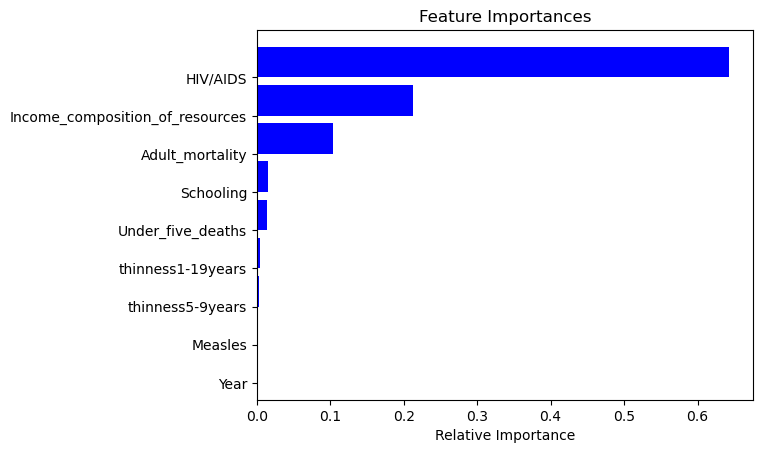

In [88]:
# using RandomForestRegressor to perform Feature selection 

x_data=sq_df2.drop(['Life_expectancy', 'Country', 'Status', 'Continent'], axis=1)
rf_model = RandomForestRegressor(random_state=1, max_depth=4)
rf_model.fit(x_data, sq_df2.Life_expectancy)
train_feature = x_data.columns
importances= rf_model.feature_importances_
indices = np.argsort(importances)[-9:]
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances [indices], color='blue', align='edge')
plt.yticks(range(len(indices)),[train_feature[i] for i in indices])
plt.xlabel('Relative Importance')
plt.show()

In [89]:
sq_df2 = sq_df2.select_dtypes(exclude=['object'])


drop_vars = ['Year','Infant_deaths','Alcohol','Percentage_expenditure','HepatitisB','Measles','Under_five_deaths','Polio','Total_expenditure','Diphtheria','GDP','Population','thinness5-9years']

# Drop the specified variables
sq_df2.drop(columns=drop_vars, inplace=True)

In [90]:
# Set the target variable
target = 'Life_expectancy'

# Split the dataset into target variable and features
y = sq_df2[target]
X = sq_df2.drop(columns=[target])
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [91]:
# Scale the data
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [92]:
# Perform multiple linear regression
reg = LinearRegression()
reg.fit(X_train_scaled, y_train)

LinearRegression()

In [93]:
coefficients = pd.DataFrame(data=reg.coef_, index=X.columns, columns=['Coefficient'])
print(coefficients)

                                 Coefficient
Adult_mortality                 -3851.588114
HIV/AIDS                         -839.539679
thinness1-19years                -412.051212
Income_composition_of_resources  2089.713799
Schooling                        1834.684104


In [94]:
# Make predictions on test data
y_pred = reg.predict(X_test_scaled)

In [95]:
lm = LinearRegression()
lm.fit(X_train, y_train)
print(f"Train accuracy {round(lm.score(X_train,y_train)*100,2)} %")
print(f"Test accuracy {round(lm.score(X_test,y_test)*100,2)} %")

Train accuracy 77.43 %
Test accuracy 77.53 %


In [102]:
# Evaluate the model
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
print('Intercept:', reg.intercept_)
print('R2 score:', r2_score(y_test, y_pred))
print('Mean Squared Error:', mean_squared_error(y_test, y_pred))
print('Mean Absolute Error:', mean_absolute_error(y_test, y_pred))

Intercept: 3553.6113614101682
R2 score: 0.7753183402135235
Mean Squared Error: 339330.7950001393
Mean Absolute Error: 419.43682109175876


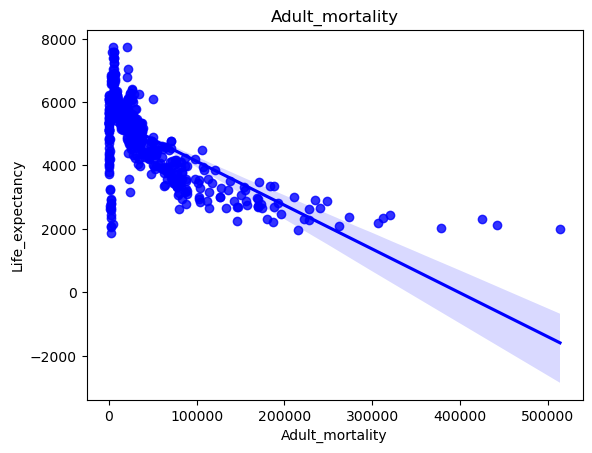

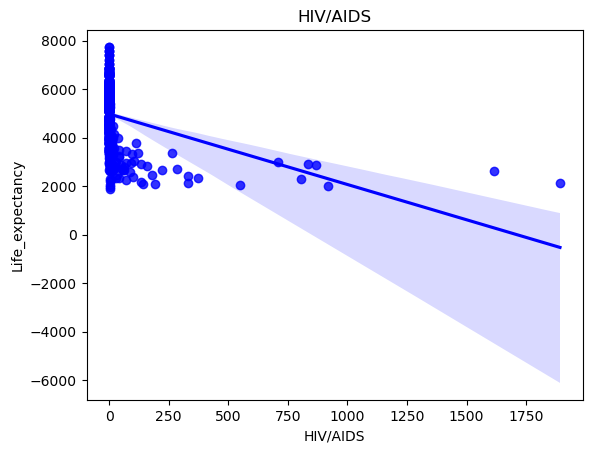

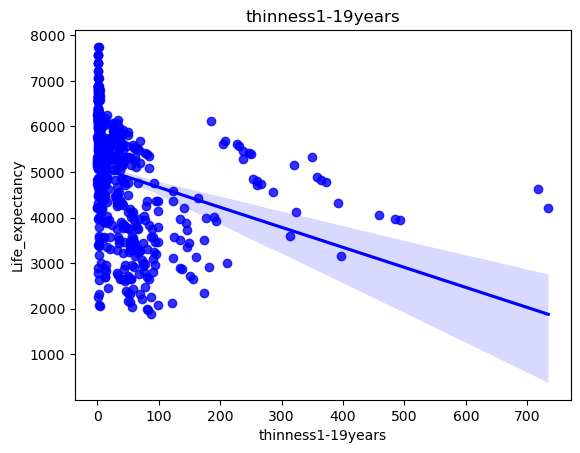

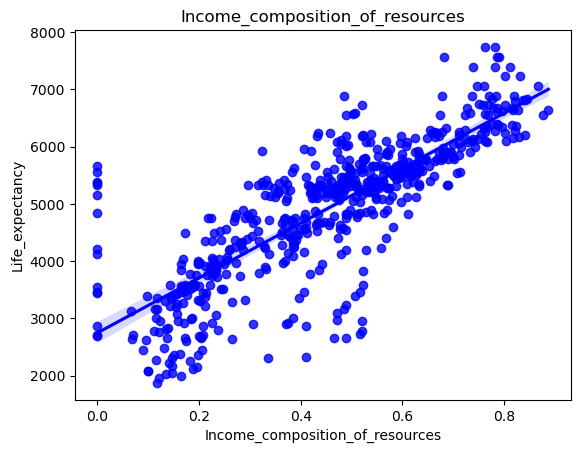

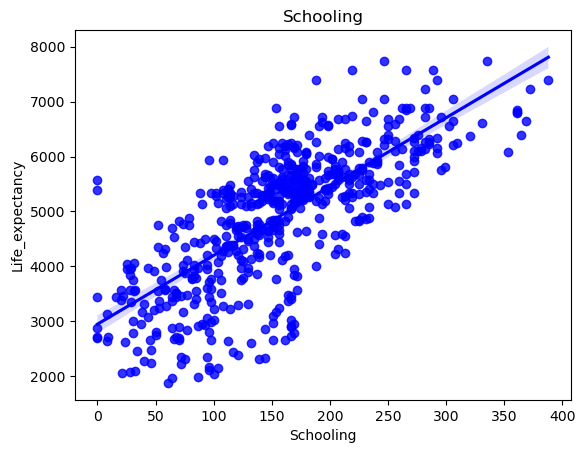

In [98]:
# Plot the graph for each variable against the dependent variable using seaborn
import seaborn as sns
for column in X_test.columns:
    sns.regplot(X_test[column], y_test, color='blue')
    plt.title(column)
    plt.xlabel(column)
    plt.ylabel(target)
    plt.show()

<AxesSubplot:xlabel='Life_expectancy'>

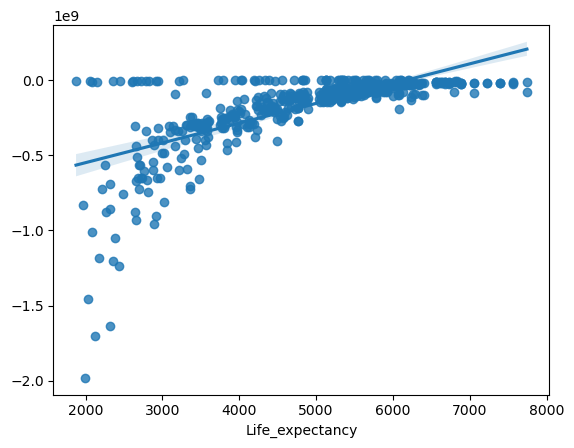

In [103]:
sns.regplot(x =  y_test, y = reg.predict(X_test))

Principal Componet Analysis (PCA)

In [105]:
sq_df_copy3 = sq_df.copy()
sq_df_copy3

,Country,Year,Status,Continent,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling
0,Afghanistan,2015,Developing,Asia,4225.00,69169.00,3844.00,0.000100,5.080785e+03,4225.0,1.331716e+06,6889.00,36.00,66.585600,4225.00,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01
16,Albania,2015,Developing,Europe,6052.84,5476.00,64.00,21.160000,1.332069e+05,9801.0,0.000000e+00,100.00,9801.00,36.000000,9801.00,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64
32,Algeria,2015,Developing,Africa,5715.36,361.00,441.00,27.931225,0.000000e+00,9025.0,3.969000e+03,576.00,9025.00,50.126400,9025.00,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36
48,Angola,2015,Developing,Africa,2745.76,112225.00,4356.00,27.931225,0.000000e+00,4096.0,1.392400e+04,9604.00,49.00,50.126400,4096.00,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96
64,Antigua and Barbuda,2015,Developing,North America,5836.96,169.00,64.00,27.931225,0.000000e+00,9801.0,0.000000e+00,100.00,7396.00,50.126400,9801.00,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21
80,Argentina,2015,Developing,South America,5821.69,13456.00,64.00,27.931225,0.000000e+00,8836.0,0.000000e+00,81.00,8649.00,50.126400,8836.00,0.01,1.813634e+08,1.885102e+15,1.00,0.81,0.682276,299.29
96,Armenia,2015,Developing,Asia,5595.04,13924.00,1.00,27.931225,0.000000e+00,8836.0,1.089000e+03,1.00,9216.00,50.126400,8836.00,0.01,1.366447e+05,8.508597e+10,4.41,4.84,0.549081,161.29
112,Australia,2015,Developed,Oceania,6855.84,3481.00,1.00,27.931225,0.000000e+00,8649.0,5.476000e+03,1.00,8649.00,50.126400,8649.00,0.01,3.198399e+09,5.659326e+14,0.36,0.36,0.877969,416.16
128,Austria,2015,Developed,Europe,6642.25,4225.00,64.00,27.931225,0.000000e+00,8649.0,9.548100e+04,100.00,8649.00,50.126400,8649.00,0.01,1.906715e+09,7.453161e+13,3.61,4.41,0.795664,252.81
144,Azerbaijan,2015,Developing,Asia,5285.29,13924.00,25.00,27.931225,0.000000e+00,9216.0,0.000000e+00,36.00,9604.00,50.126400,9216.00,0.01,3.059619e+03,9.310978e+13,7.84,8.41,0.574564,161.29


In [106]:
from sklearn.preprocessing import StandardScaler

sq_df_copy3 = sq_df_copy3.select_dtypes(exclude=['object'])

# Scale  data
scaler = StandardScaler()
X = scaler.fit_transform(sq_df_copy3)

# Applying PCA to the scaled data
pca = PCA()
pca.fit(X)

# Examining the variance ratio of each principal component
explained_var_ratio = pca.explained_variance_ratio_


In [107]:
# number of principal components
num_components = 3

# Transforming the data 
pca = PCA(n_components=num_components)
X_pca = pca.fit_transform(X)

# Examining the loadings of each principal component
loadings = pca.components_


loadings_df = pd.DataFrame(loadings, columns=sq_df_copy3.columns, index=['PC1', 'PC2', 'PC3'])

print("Loadings of the first three principal components:")
print(loadings_df)


from sklearn.linear_model import LinearRegression
y = sq_df_copy3['Life_expectancy']
reg = LinearRegression()
reg.fit(X_pca, y)
y_pred = reg.predict(X_pca)

Loadings of the first three principal components:
         Year  Life_expectancy  Adult_mortality  Infant_deaths   Alcohol  \
PC1 -0.093811        -0.357108         0.222689       0.181723 -0.227219   
PC2  0.057640         0.201985        -0.182152       0.469327  0.095502   
PC3 -0.046409        -0.059545         0.154425      -0.013279  0.153496   

     Percentage_expenditure  HepatitisB   Measles  Under_five_deaths  \
PC1               -0.162820   -0.177891  0.074043           0.183670   
PC2                0.132508    0.036760  0.103636           0.464860   
PC3                0.561583   -0.321794  0.028623          -0.008205   

        Polio  Total_expenditure  Diphtheria  HIV/AIDS       GDP  Population  \
PC1 -0.281403          -0.143293   -0.285137  0.103016 -0.180691    0.109382   
PC2  0.117865           0.030543    0.120208 -0.103280  0.140608    0.330103   
PC3 -0.310013           0.123337   -0.319845  0.129975  0.534251   -0.015187   

     thinness1-19years  thinness5-9

R-squared: 0.80
Mean Squared Error: 324747.66
Root Mean Squared Error: 569.87


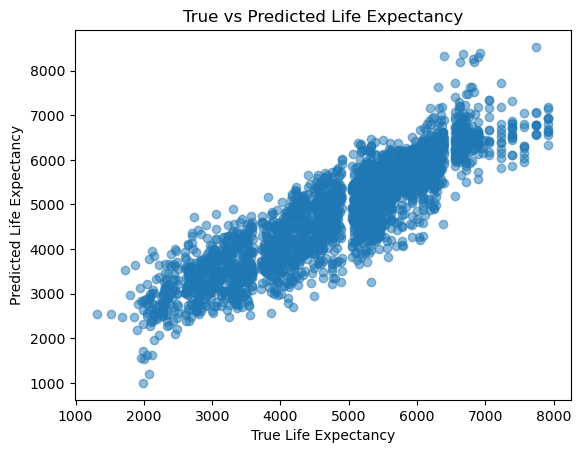

In [108]:

r2 = r2_score(y, y_pred)
print(f"R-squared: {r2:.2f}")


mse = mean_squared_error(y, y_pred)
print(f"Mean Squared Error: {mse:.2f}")


rmse = np.sqrt(mse)
print(f"Root Mean Squared Error: {rmse:.2f}")

# scatterplot of true vs predicted target values
plt.scatter(y, y_pred, alpha=0.5)
plt.xlabel("True Life Expectancy")
plt.ylabel("Predicted Life Expectancy")
plt.title("True vs Predicted Life Expectancy")
plt.show()

In [109]:
#create new datafram using copy function
sq_df_copy4 = sq_df.copy()
sq_df_copy4

,Country,Year,Status,Continent,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling
0,Afghanistan,2015,Developing,Asia,4225.00,69169.00,3844.00,0.000100,5.080785e+03,4225.0,1.331716e+06,6889.00,36.00,66.585600,4225.00,0.01,3.413588e+05,1.138151e+15,295.84,299.29,0.229441,102.01
16,Albania,2015,Developing,Europe,6052.84,5476.00,64.00,21.160000,1.332069e+05,9801.0,0.000000e+00,100.00,9801.00,36.000000,9801.00,0.01,1.563592e+07,8.336501e+08,1.44,1.69,0.580644,201.64
32,Algeria,2015,Developing,Africa,5715.36,361.00,441.00,27.931225,0.000000e+00,9025.0,3.969000e+03,576.00,9025.00,50.126400,9025.00,0.01,1.707973e+07,1.589739e+15,36.00,33.64,0.552049,207.36
48,Angola,2015,Developing,Africa,2745.76,112225.00,4356.00,27.931225,0.000000e+00,4096.0,1.392400e+04,9604.00,49.00,50.126400,4096.00,3.61,1.365889e+07,7.761434e+12,68.89,67.24,0.281961,129.96
64,Antigua and Barbuda,2015,Developing,North America,5836.96,169.00,64.00,27.931225,0.000000e+00,9801.0,0.000000e+00,100.00,7396.00,50.126400,9801.00,0.04,1.840622e+08,4.310133e+12,10.89,10.89,0.614656,193.21
80,Argentina,2015,Developing,South America,5821.69,13456.00,64.00,27.931225,0.000000e+00,8836.0,0.000000e+00,81.00,8649.00,50.126400,8836.00,0.01,1.813634e+08,1.885102e+15,1.00,0.81,0.682276,299.29
96,Armenia,2015,Developing,Asia,5595.04,13924.00,1.00,27.931225,0.000000e+00,8836.0,1.089000e+03,1.00,9216.00,50.126400,8836.00,0.01,1.366447e+05,8.508597e+10,4.41,4.84,0.549081,161.29
112,Australia,2015,Developed,Oceania,6855.84,3481.00,1.00,27.931225,0.000000e+00,8649.0,5.476000e+03,1.00,8649.00,50.126400,8649.00,0.01,3.198399e+09,5.659326e+14,0.36,0.36,0.877969,416.16
128,Austria,2015,Developed,Europe,6642.25,4225.00,64.00,27.931225,0.000000e+00,8649.0,9.548100e+04,100.00,8649.00,50.126400,8649.00,0.01,1.906715e+09,7.453161e+13,3.61,4.41,0.795664,252.81
144,Azerbaijan,2015,Developing,Asia,5285.29,13924.00,25.00,27.931225,0.000000e+00,9216.0,0.000000e+00,36.00,9604.00,50.126400,9216.00,0.01,3.059619e+03,9.310978e+13,7.84,8.41,0.574564,161.29


In [110]:
print(sq_df_copy4.isnull().sum()) 
print(sq_df_copy4.isin([np.inf, -np.inf]).sum()) 

Country                            0
Year                               0
Status                             0
Continent                          0
Life_expectancy                    0
Adult_mortality                    0
Infant_deaths                      0
Alcohol                            0
Percentage_expenditure             0
HepatitisB                         0
Measles                            0
Under_five_deaths                  0
Polio                              0
Total_expenditure                  0
Diphtheria                         0
HIV/AIDS                           0
GDP                                0
Population                         0
thinness1-19years                  0
thinness5-9years                   0
Income_composition_of_resources    0
Schooling                          0
dtype: int64
Country                            0
Year                               0
Status                             0
Continent                          0
Life_expectancy          

In [111]:
# Replace missing values in numeric columns with the median value
numeric_columns = sq_df_copy4.select_dtypes(include=np.number).columns
sq_df_copy4[numeric_columns] = sq_df_copy4[numeric_columns].fillna(sq_df_copy4[numeric_columns].median())

# Replace missing values in categorical columns with the mode value
categorical_columns = sq_df_copy4.select_dtypes(include='object').columns
if sq_df_copy4[categorical_columns].isnull().any().any():
    sq_df_copy4[categorical_columns] = sq_df_copy4[categorical_columns].fillna(sq_df_copy4[categorical_columns].mode().iloc[0])

# Check missing values
print(sq_df_copy4.isnull().sum())

Country                            0
Year                               0
Status                             0
Continent                          0
Life_expectancy                    0
Adult_mortality                    0
Infant_deaths                      0
Alcohol                            0
Percentage_expenditure             0
HepatitisB                         0
Measles                            0
Under_five_deaths                  0
Polio                              0
Total_expenditure                  0
Diphtheria                         0
HIV/AIDS                           0
GDP                                0
Population                         0
thinness1-19years                  0
thinness5-9years                   0
Income_composition_of_resources    0
Schooling                          0
dtype: int64


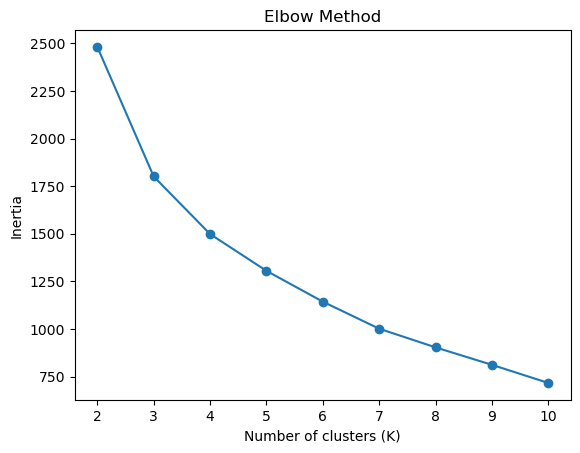

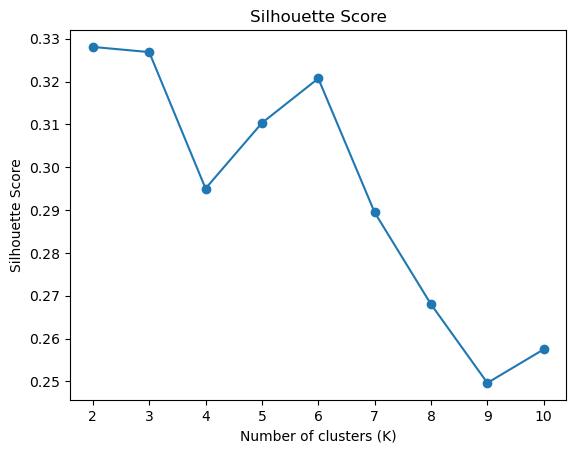

In [114]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.metrics import silhouette_score
from IPython.display import display
# Aggregate the data by country 
agg_df = sq_df_copy4.groupby('Country').mean().reset_index()

# Scale the numerical features
numerical_features = agg_df.select_dtypes(include=[np.number])
scaler = StandardScaler()
scaled_features = scaler.fit_transform(numerical_features)

# Determine the optimal number of clusters
cluster_range = range(2, 11)
inertia_values = []
silhouette_scores = []

for k in cluster_range:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(scaled_features)
    
    inertia_values.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(scaled_features, kmeans.labels_))

# Plot the elbow method and silhouette score graphs to choose the optimal K
plt.figure()
plt.plot(cluster_range, inertia_values, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

plt.figure()
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.xlabel('Number of clusters (K)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score')
plt.show()

,Year,Life_expectancy,Adult_mortality,Infant_deaths,Alcohol,Percentage_expenditure,HepatitisB,Measles,Under_five_deaths,Polio,Total_expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness1-19years,thinness5-9years,Income_composition_of_resources,Schooling
Cluster,,,,,,,,,,,,,,,,,,,
0,2007.5,6572.037370,7913.690755,8.154036e+01,92.221414,3.186521e+07,7504.843750,8.283267e+06,1.087096e+02,8804.513021,72.306874,8778.466146,0.010000,1.334182e+09,3.353777e+14,1.977943,1.740208,0.758825,267.309687
1,2007.5,3599.832087,75076.515904,1.158949e+04,11.826726,2.700372e+04,5991.628348,2.729162e+08,2.526015e+04,4828.072824,30.429367,4809.328962,23.445781,5.245105e+06,1.154599e+15,80.572232,82.478817,0.235665,86.872723
2,2007.5,5346.612246,22775.333822,1.211590e+03,39.004161,6.074615e+05,8192.354167,6.560354e+07,1.726059e+03,8541.186198,40.218194,8507.542969,0.501940,8.495675e+07,3.846177e+14,22.330820,22.359004,0.490259,169.360612
3,2007.5,4282.879375,30510.953125,1.953997e+06,5.952183,1.817334e+03,3495.750000,2.532887e+09,3.462500e+06,4949.000000,20.958288,4841.187500,0.068125,1.009202e+06,4.437570e+17,734.480000,780.996875,0.303590,100.971875
4,2007.5,2778.117917,231831.125000,7.613542e+02,23.517730,1.385044e+05,6717.208333,1.500413e+08,1.731312e+03,6974.000000,52.914936,7056.375000,654.796667,1.024397e+07,2.589814e+14,63.260104,71.163958,0.272554,122.788229


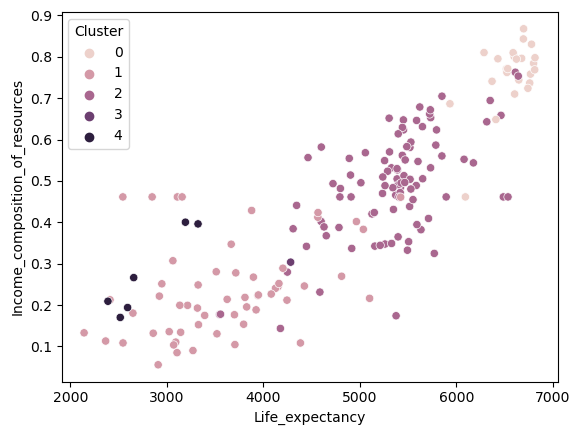

In [115]:
optimal_k = 5  

# Applying K-means clustering with optimal K
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
kmeans.fit(scaled_features)
cluster_labels = kmeans.labels_


agg_df['Cluster'] = cluster_labels


# You can use groupby to see the mean values 
cluster_summary = agg_df.groupby('Cluster').mean()
display(cluster_summary)

# create scatter plots
sns.scatterplot(x='Life_expectancy', y='Income_composition_of_resources', hue='Cluster', data=agg_df)
plt.show()


In [117]:
# countries in each cluster
cluster_0_countries = agg_df[agg_df['Cluster'] == 0]['Country']
cluster_1_countries = agg_df[agg_df['Cluster'] == 1]['Country']
cluster_2_countries = agg_df[agg_df['Cluster'] == 2]['Country']
cluster_3_countries = agg_df[agg_df['Cluster'] == 3]['Country']
cluster_4_countries = agg_df[agg_df['Cluster'] == 4]['Country']

print("Cluster 0 countries:")
print(cluster_0_countries)
print("\nCluster 1 countries:")
print(cluster_1_countries)
print("\nCluster 2 countries:")
print(cluster_2_countries)
print("\nCluster 3 countries:")
print(cluster_3_countries)
print("\nCluster 4 countries:")
print(cluster_4_countries)

Cluster 0 countries:
7                     Australia
8                       Austria
15                      Belgium
30                       Canada
46                      Denmark
57                      Finland
58                       France
62                      Germany
64                       Greece
73                      Iceland
78                      Ireland
80                        Italy
82                        Japan
96                   Luxembourg
114                 Netherlands
115                 New Zealand
119                      Norway
128                    Portugal
129                       Qatar
146                    Slovenia
151                       Spain
156                      Sweden
157                 Switzerland
174    United States of America
Name: Country, dtype: object

Cluster 1 countries:
0                           Afghanistan
3                                Angola
12                           Bangladesh
17                                Benin
